In [1]:
import pandas as pd
import numpy as np
import os
import pickle
import json
import torch
from torch import nn
from torch.nn import functional as F
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
import glob
import significantdigits as sig
import matplotlib.image as mpimg
import glob
from IPython.display import display
from IPython.display import Image as Im
from PIL import Image
from matplotlib.colors import LogNorm, Normalize
from matplotlib.ticker import MaxNLocator
from matplotlib.colors import TwoSlopeNorm
import random
import nibabel as nib
from nilearn import plotting
from matplotlib.colors import LinearSegmentedColormap
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from scipy.stats import ttest_rel
from typing import Tuple
import matplotlib
import re
from concurrent.futures import ThreadPoolExecutor
import threading
from scipy import stats
import nilearn
from nilearn import masking, image
import scipy.ndimage as ndimage
from scipy.ndimage import gaussian_filter, binary_dilation

from nan_ops import NaNPool2d, NaNConv2d
from compute_similarity import load_and_conform_image, PSNR #getvol
# from pytorch_msssim import ssim, ms_ssim

/home/ine5/dynamo_env/lib/python3.10/site-packages/torch/cuda/__init__.py:619: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")


## Make Head Mask Manually

* Figure out how to make good mask for raw images

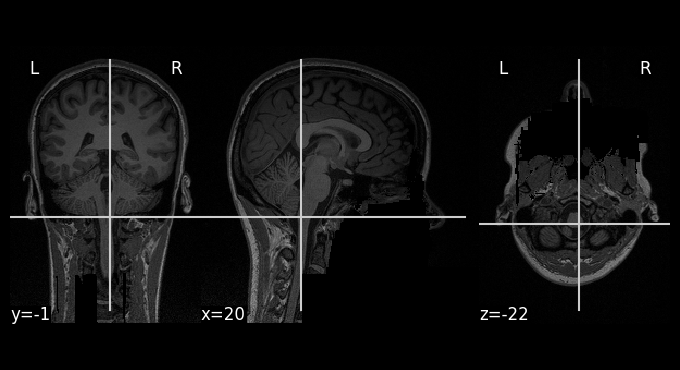

In [17]:
# input = nib.load('/scratch/ine5/fs_subject_ieee/sub-0003002/norm.nii.gz')
input = nib.load('/scratch/vinuyans/skips/raw_data/sub-0003002_ses-1_run-1_T1w.nii.gz')

plotting.plot_anat(input)

Binary mask generated with shape: (256, 256, 256)


<Axes: >

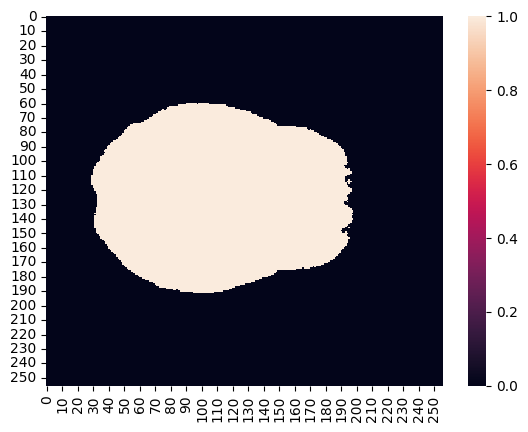

In [47]:
from scipy.ndimage import gaussian_filter, binary_dilation

def smooth_and_binarize_mask(volume, sigma=1.0, threshold=0.1, dilation_iterations=1):
    """
    Smooth a 3D array, threshold non-zero values, and binarize the result.

    Parameters:
    - volume: 3D NumPy array to process
    - sigma: float, standard deviation for Gaussian kernel (default=1.0)
    - threshold: float, threshold value for binarization (default=0.1)
    
    Returns:
    - binary_mask: 3D binary mask as a NumPy array
    """

    # Step 1: Apply Gaussian smoothing to the input volume
    smoothed_volume = gaussian_filter(volume, sigma=sigma)
    
    # Step 2: Threshold values that are not zero
    thresholded_volume = np.where(smoothed_volume > threshold, 1, 0)
    
    # Step 3: Return the binary mask
    binary_mask = (thresholded_volume > 0).astype(np.uint8)
    
    # Step 4: Apply binary dilation to close any holes
    dilated_mask = binary_dilation(binary_mask, iterations=dilation_iterations).astype(np.uint8)
    
    return dilated_mask


input = nib.load('/scratch/ine5/fs_subject_ieee/sub-0003002/norm.nii.gz')

# Apply the smoothing and binarization function
mask = smooth_and_binarize_mask(input.get_fdata(), sigma=0., threshold=0.)

print("Binary mask generated with shape:", mask.shape)

sns.heatmap(mask[:,100])

Binary mask generated with shape: (176, 256, 256)


<Axes: >

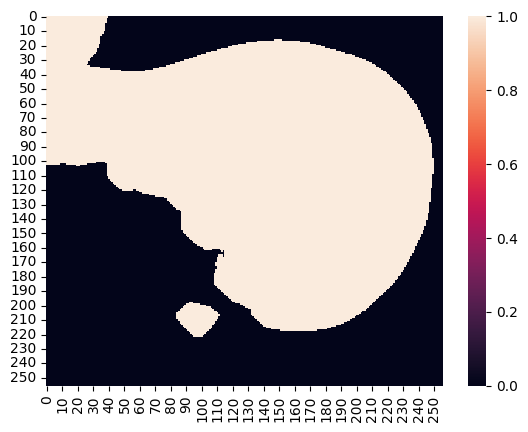

In [44]:
mask = smooth_and_binarize_mask(input.get_fdata(), sigma=2.5, threshold=40, dilation_iterations=5)

print("Binary mask generated with shape:", mask.shape)

sns.heatmap(mask[100])

In [48]:
img = nib.Nifti1Image(mask, input.affine)

nib.save(img, 'fondue_processed_mask.nii.gz')

In [23]:
smoothed_volume = gaussian_filter(input.get_fdata()[100, :10, :10], sigma=1.5)

smoothed_volume

array([[31.84866292, 43.61496825, 57.30471593, 63.7771607 , 62.08337446,
        57.30771851, 54.32668274, 54.63259226, 56.65298829, 58.12590898],
       [33.10870504, 44.00046092, 56.11404225, 61.83590644, 61.8341428 ,
        60.40169609, 59.79504461, 60.15303818, 60.98418154, 61.58715403],
       [35.11905037, 44.81624887, 55.07054655, 60.35276032, 62.91099485,
        65.56610225, 67.43878639, 67.28812763, 66.0359426 , 65.08712089],
       [37.03462462, 46.15630677, 55.84326122, 61.69896964, 66.02782652,
        70.27475419, 72.41099848, 71.12014841, 68.10694557, 65.89275459],
       [38.05159119, 47.50783576, 58.03384788, 64.91066224, 69.2635239 ,
        72.02137565, 72.41755487, 70.47632155, 67.81378676, 66.09828452],
       [38.68208885, 48.71256095, 60.01361711, 67.02732322, 70.06801088,
        70.49125985, 69.44464805, 68.44488841, 68.5026682 , 69.1214452 ],
       [40.18748108, 50.19705022, 60.93609437, 66.67095043, 68.06827945,
        67.1448983 , 66.04299406, 66.82837006

## Embeddings

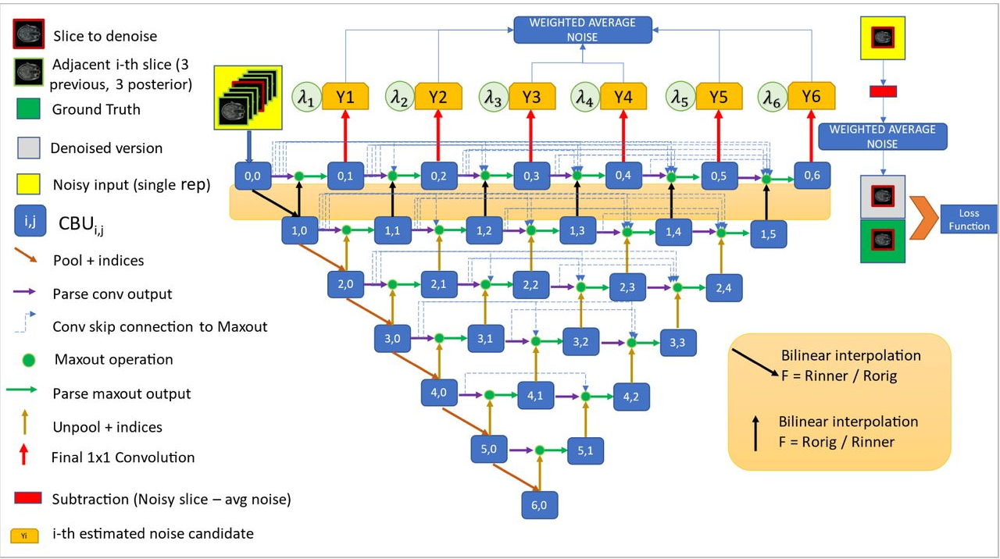

### Visualize Embeddings Across Thresholds

In [9]:
def graph_arch(name, cmap, nan_root, plane, cut, min = None, max = None):
    num_rows = 8
    padding = 0.02

    # Create a figure
    fig = plt.figure(figsize=(30, 25))

    num_cols = 6
    total_width = num_cols / num_rows
    total_width_with_padding = total_width + (num_cols - 1) * padding
    left_start = (1 - total_width_with_padding) / 2
    for col in range(6):
        # Calculate the subplot position with padding
        left = left_start + col * (1 / num_rows + padding)
        bottom = (num_rows  - 1) / num_rows  # Reverse the row position
        width = 1 / num_rows - padding
        height = 1 / num_rows - padding
        
        # Add subplot with the calculated position
        ax = fig.add_axes([left, bottom, width, height])
        ax.set_visible(True)

    # Plot heatmaps in a reverse pyramid shape with padding
    for row in range(num_rows):
        if row != 0:
            num_cols = num_rows - row
            total_width = num_cols / num_rows
            total_width_with_padding = total_width + (num_cols - 1) * padding
            left_start = (1 - total_width_with_padding) / 2
            
            for col in range(num_cols):
                # Calculate the subplot position with padding
                left = left_start + col * (1 / num_rows + padding)
                bottom = (num_rows - row - 1) / num_rows  # Reverse the row position
                width = 1 / num_rows - padding
                height = 1 / num_rows - padding
                
                # Add subplot with the calculated position
                ax = fig.add_axes([left, bottom, width, height])
                ax.set_visible(True)
                

    # Plot Y graphs 
    idx =0
    for i in range(1,7):
        a=pickle.load(open(f'{nan_root}/{plane}_y{i}.pkl', 'rb'))[0]
        # ieee=pickle.load(open(f'{ieee_root}/y{i}.pkl', 'rb'))
        # diff_rel = diff_rel.nan_to_num(nan=-1, posinf=2)
        gc = sns.heatmap(a.squeeze(), cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
        
        gc.set_title(f'y{i}')
        idx += 1

    # Plot 1_X graphs
    # Plot single 0_0 with 1_X row
    a=pickle.load(open(f'{nan_root}/{plane}_0_0_base_output.pkl', 'rb'))[0]
    # ieee=pickle.load(open(f'{ieee_root}/0_0_base_output.pkl', 'rb'))[0]
    # diff_rel = diff_rel.nan_to_num(nan=-1, posinf=2)
    gc = sns.heatmap(a.squeeze()[cut], cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
    
    gc.set_title(f'0_0_base_output')
    idx += 1

    for i in range(6):
        # if i == 0: continue
        a=pickle.load(open(f'{nan_root}/{plane}_1_{i}_bilinear.pkl', 'rb'))[0]
        # ieee=pickle.load(open(f'{ieee_root}/1_{i}_bilinear.pkl', 'rb'))[0]
        # diff_rel = diff_rel.nan_to_num(nan=-1, posinf=2)
        # print(f'{nan_root}/{plane}_1_{i}_bilinear.pkl', 'rb')
        gc = sns.heatmap(a.squeeze()[cut], cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
        gc.set_title(f'1_{i}_bilinear')
        idx += 1

    # Plot Pool & unpool graphs
    for i in range(1,6):
        a=pickle.load(open(f'{nan_root}/{slurm/t0.5_sub-0003002_ses-1_run-1_T1w.nii.gz_60.outplane}_{i}_0_pool.pkl', 'rb'))[0]
        # ieee=pickle.load(open(f'{ieee_root}/{i}_0_pool.pkl', 'rb'))[0]
        # diff_rel = diff_rel.nan_to_num(nan=-1, posinf=2)
        gc = sns.heatmap(a.squeeze()[cut], cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
        
        gc.set_title(f'{i}_0_pool')
        idx += 1
        for j in range(6-i):
            a=pickle.load(open(f'{nan_root}/{plane}_{i+1}_{j}_unpool.pkl', 'rb'))[0]
            # ieee=pickle.load(open(f'{ieee_root}/{i+1}_{j}_unpool.pkl', 'rb'))[0]
            gc = sns.heatmap(a.squeeze()[cut], cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
            
            gc.set_title(f'{i+1}_{j}_unpool')
            idx += 1
    fig.axes[idx].set_visible(False)

    plt.suptitle(name, y=1.02, fontsize=15);
    # Show the plot
    plt.show()


#### Raw Images

**Threshold 0.75**

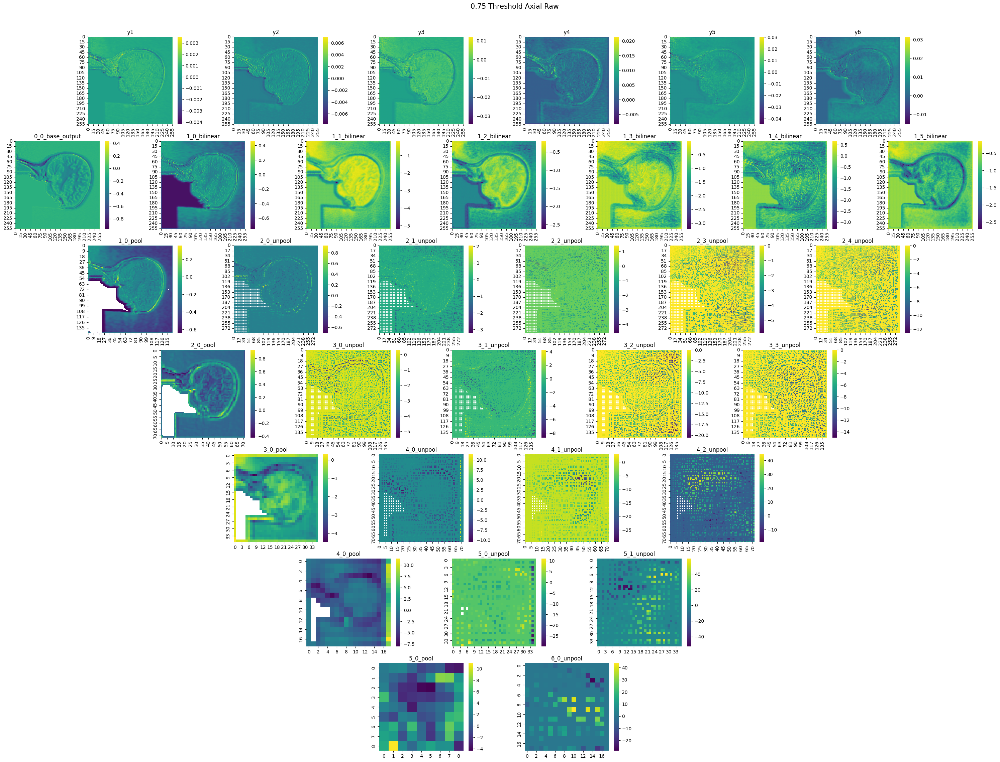

In [27]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh075/raw'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.75 Threshold Axial Raw', cmap, nan_root, 'axial', 10)


**Threshold 0.3**

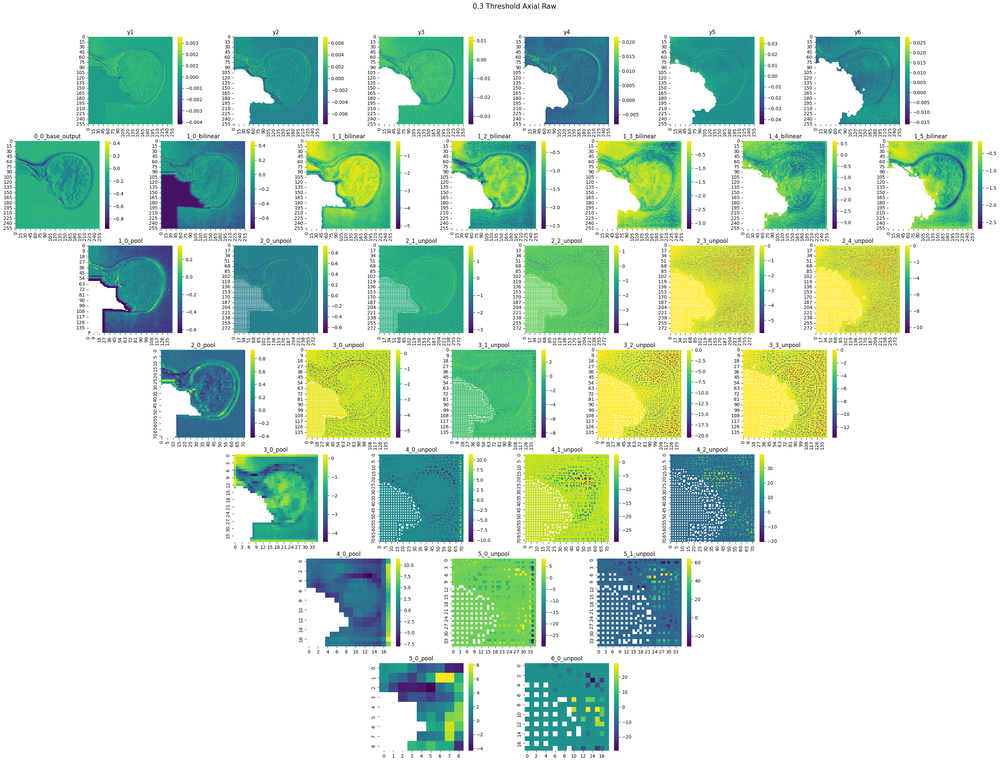

In [26]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh03/raw'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.3 Threshold Axial Raw', cmap, nan_root, 'axial', 10)


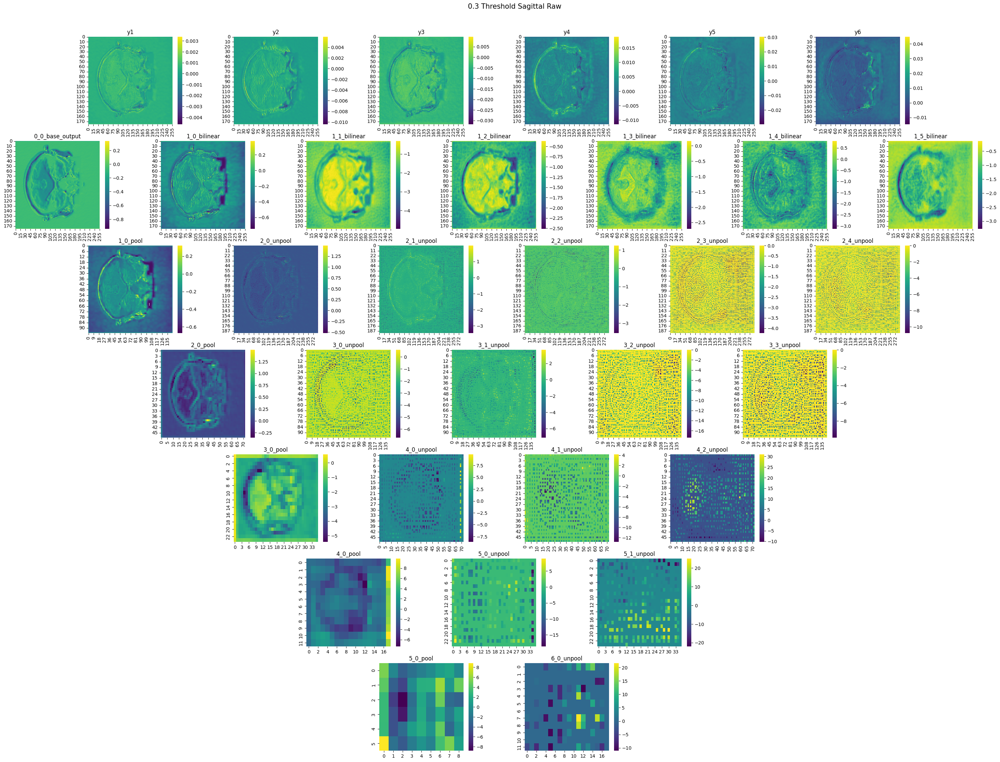

In [51]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh03/raw'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.3 Threshold Sagittal Raw', cmap, nan_root, 'sagittal', 10)


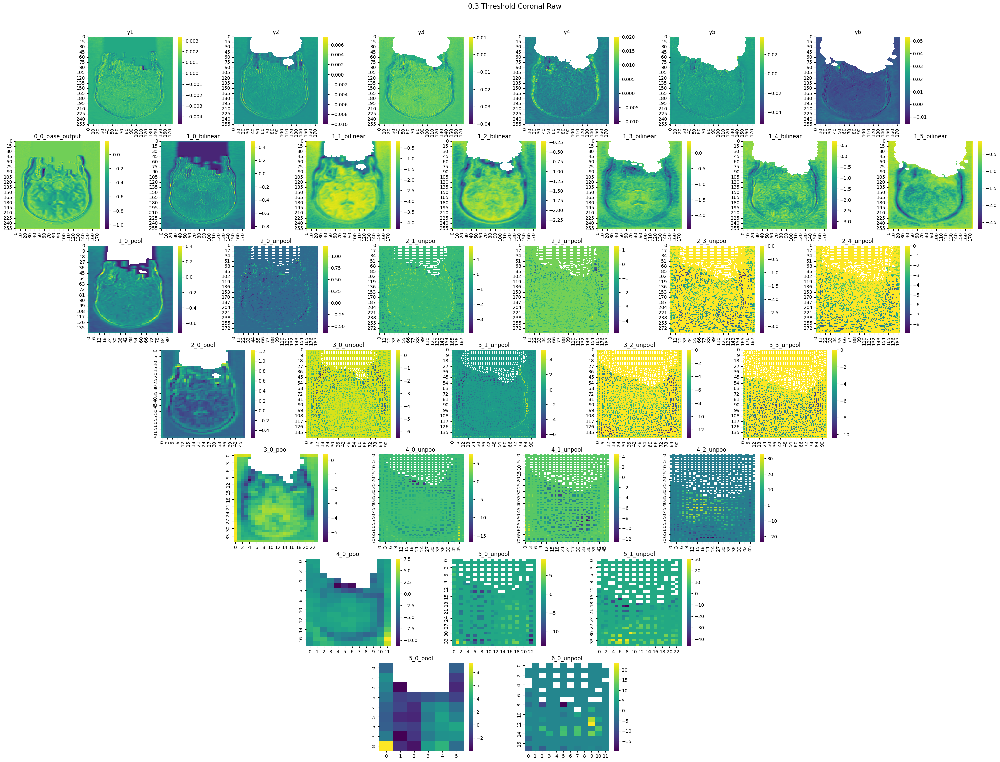

In [50]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh03/raw'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.3 Threshold Coronal Raw', cmap, nan_root, 'coronal', 10)


**Threshold 0.4**

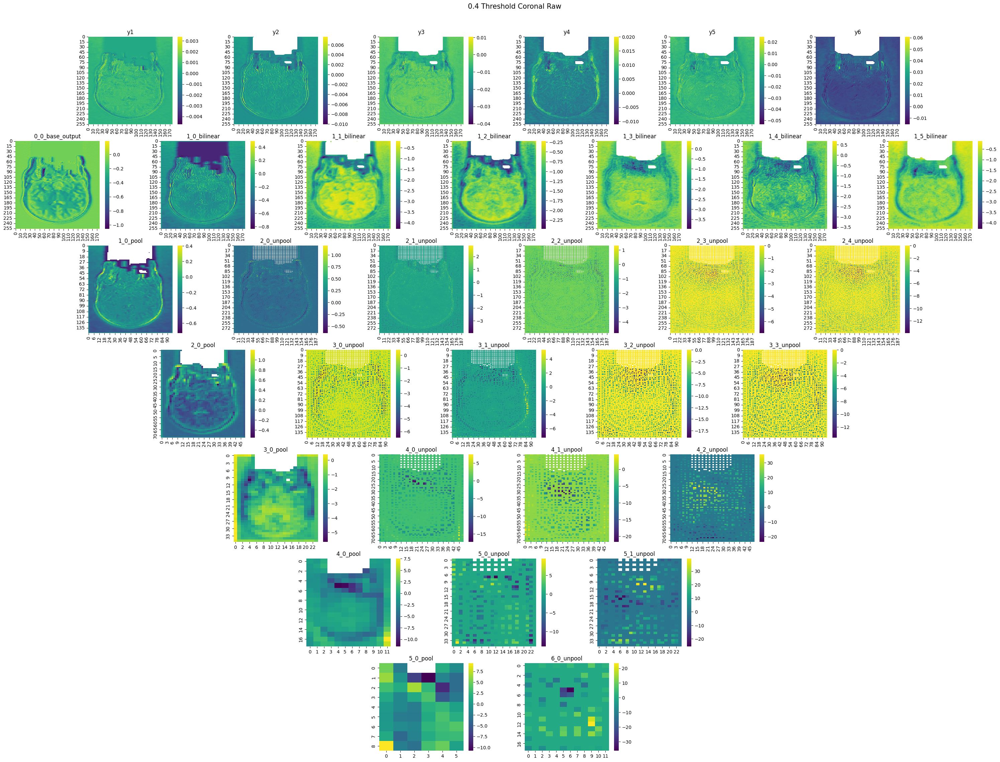

In [3]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh04/raw'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.4 Threshold Coronal Raw', cmap, nan_root, 'coronal', 10)

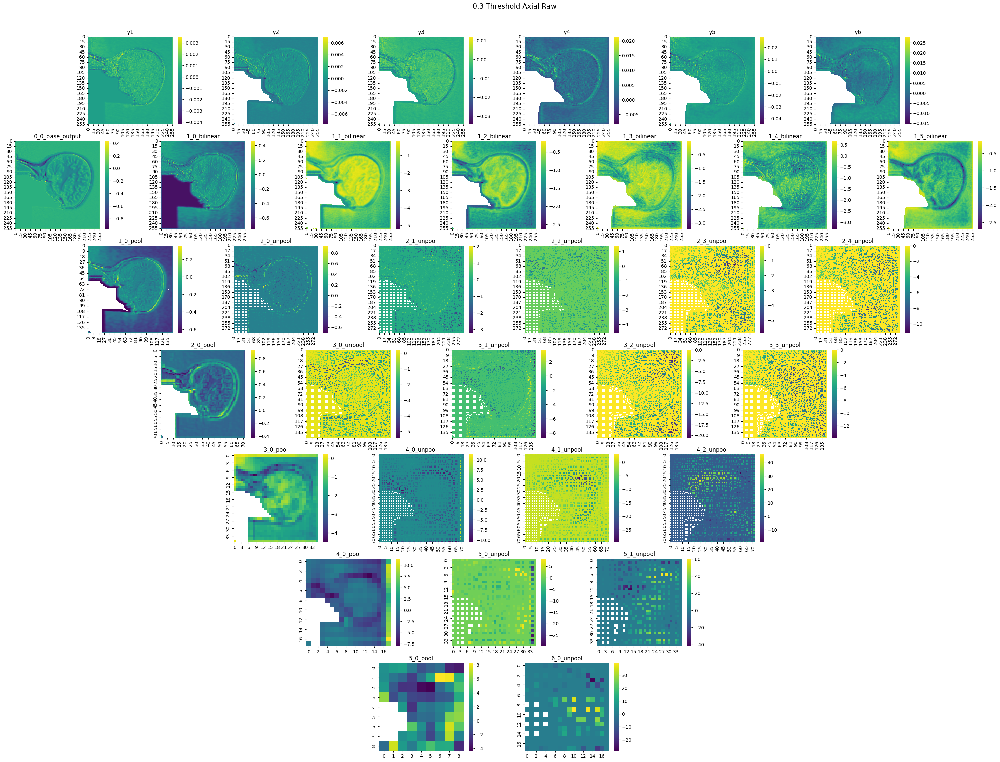

In [10]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh04/raw'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.3 Threshold Axial Raw', cmap, nan_root, 'axial', 10)


**Threshold 0.5**

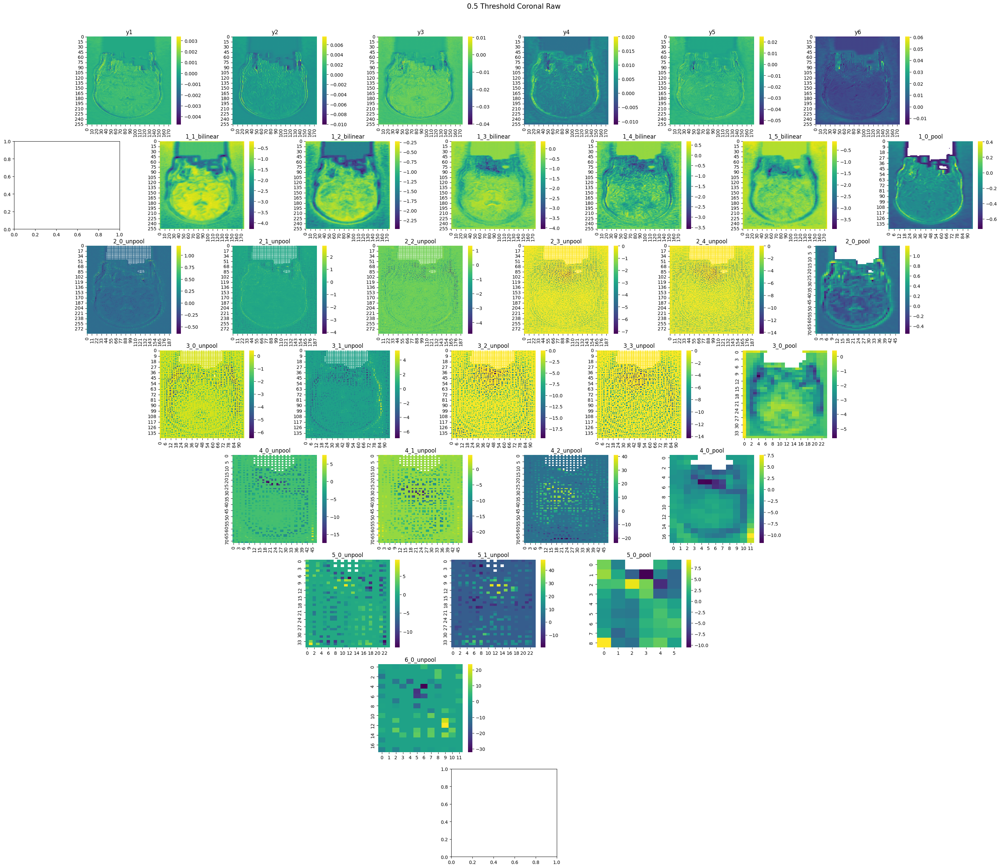

In [18]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh05/raw'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.5 Threshold Coronal Raw', cmap, nan_root, 'coronal', 10)


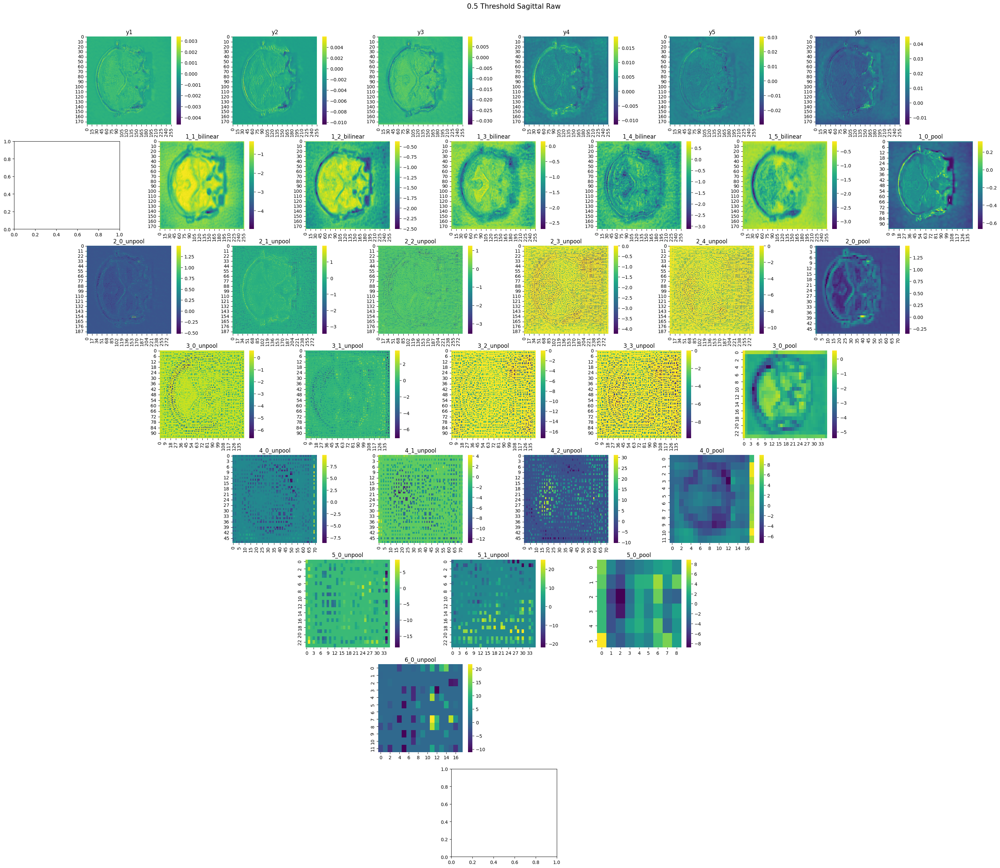

In [17]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh05/raw'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.5 Threshold Sagittal Raw', cmap, nan_root, 'sagittal', 10)


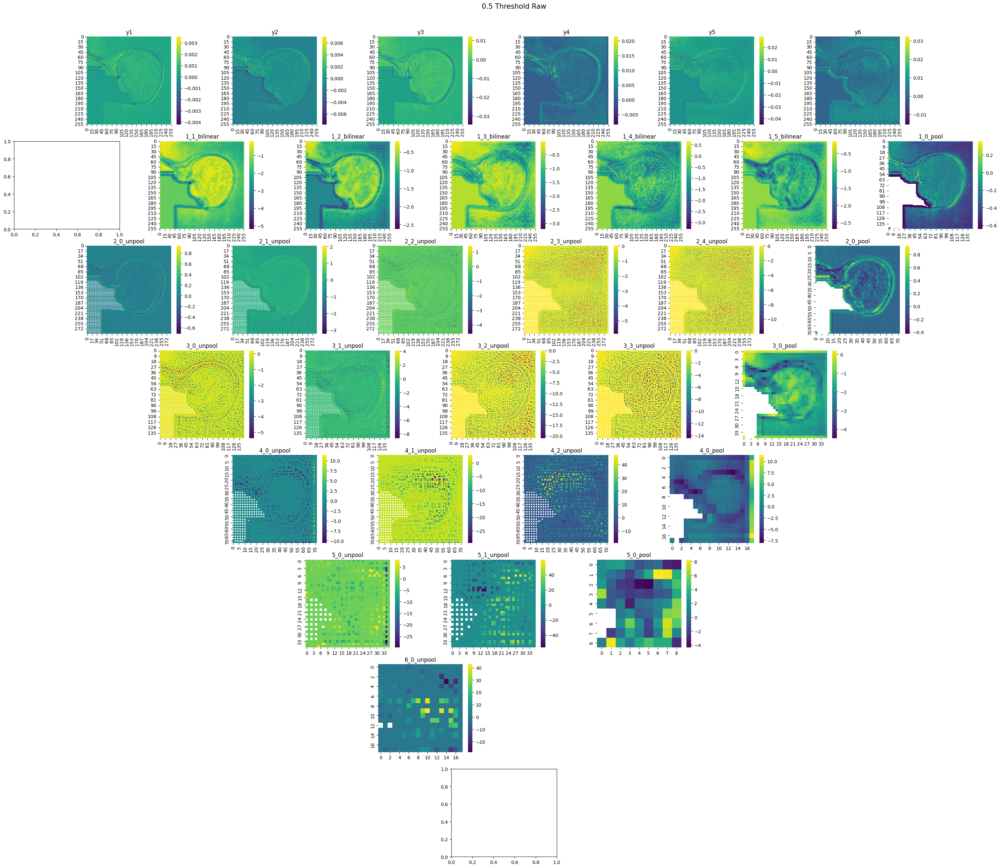

In [12]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh05/raw'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.5 Threshold Axial Raw', cmap, nan_root, 'axial', 10)


#### Processed

**Threshold 0.75 Processed**

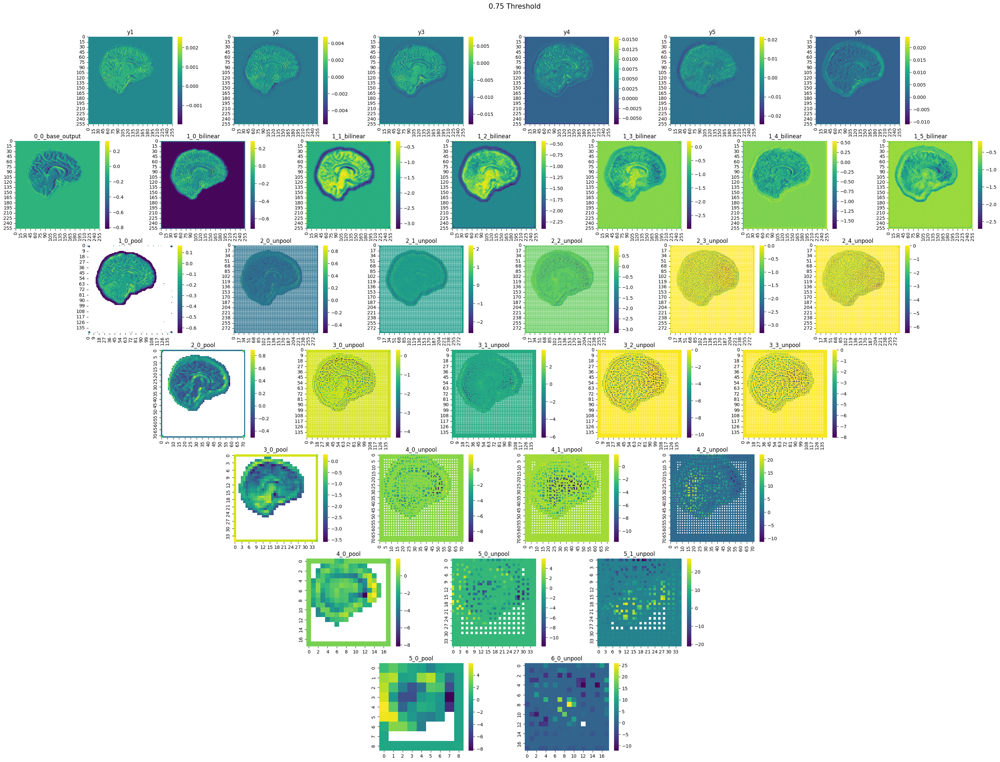

In [22]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh075/'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.75 Threshold', cmap, nan_root, 'axial', 10)


**Threshold 1 Epsilon 1e-5**

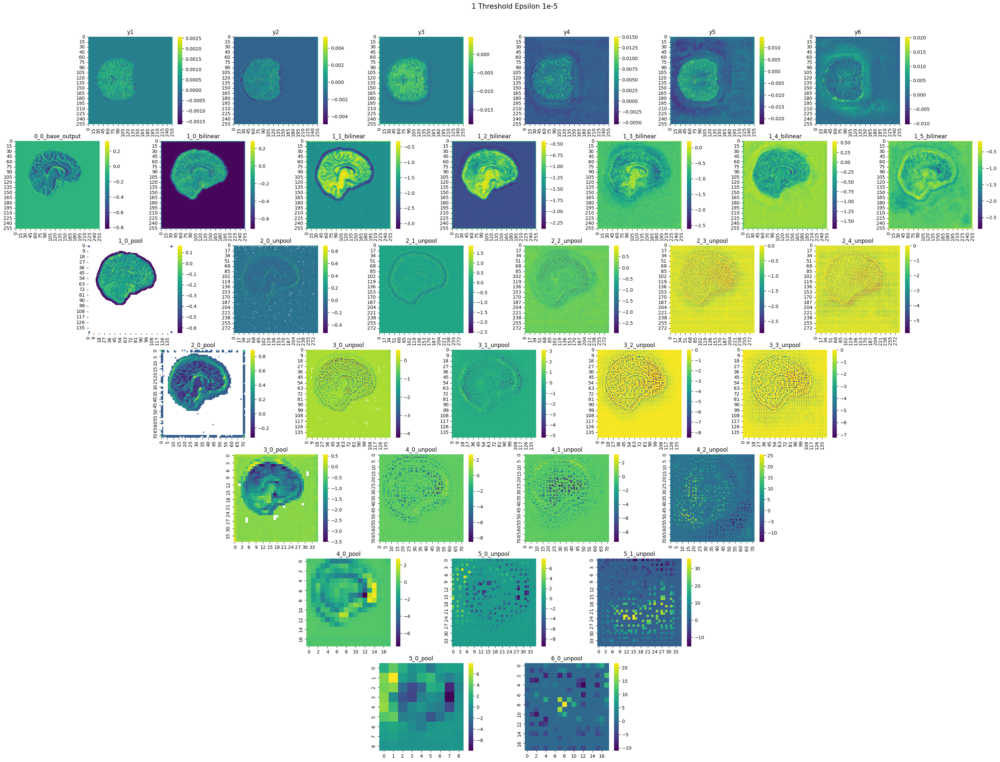

In [21]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh10/'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('1 Threshold Epsilon 1e-5', cmap, nan_root, 'axial', 10)

### Experimentation

**VGG Block**
- Input x
- Parametric ReLU (Prelu)
    - ReLU forces all negative values to zero, while PReLU allows some negative values to pass through (with a small negative slope), providing more flexibility in learning patterns in the data.
- Performs conv on Prelu output; obtains x0
- Concatenates and takes the max out of original input and Prelu + conv output; obtains x1_max
- Performs Prelu and another conv on x1_max; obtains x1
- Concatenates and takes the max out of x1 and x1_max; obtains x2_max
- Performs conv on Prelu output; obtains out

**VGG Input Block**
- Input x
- Performs conv; obtains x0
- Performs Prelu + conv; obtains x1
- Concatenates and takes the max out of x0 and x1; obtains x2_max
- Performs Prelu + conv; obtains out


**Model**
- x0_0 = VGGBLockInput 0_0 --> 0_0_base_output
- x0_02 = Interpolation --> 0_0_bilinear
- x1_0 = VGGBlock 1_0 x0_02
- c_max = Concatenate + max out x0_0 and interpolated x1_0 
- x0_1 = VGGBlock 0_1 c_max --> 1_0_bilinear
- pool_x1_0 = Max pooling x1_0 --> 1_0_pool
- x2_0 = VGGBlock 2_0 pool_x1_0
- c2 = Unpool x2_0 --> 2_0_unpool
- c_max = Concatenate + max out x1_0 and c2 --> 1_1_max_input
- x1_1 = VGGBlock 1_1 c_max **DIAGRAMMED UP TO HERE**
- c_3 = interpolated x1_1 --> 1_1_bilinear
- c_max = Concatenate + max out x0_0, x0_1 and c_3
- x0_2 = VGGBlock 0_2 c_max 
- pool_x2_0 = Max pooling x2_0 --> 2_0_pool
- x3_0 = VGGBlock 3_0 pool_x2_0
- c2 = Unpool x3_0 --> 3_0_unpool
- c_max = Concatenate + max out x2_0 and c2 --> 2_1_max_input
- x2_1 = VGGBlock 2_1 c_max 
- c3 = Unpool x2_1 --> 2_1_unpool
- c_max = Concatenate + max out x1_0, x1_1 and c3 --> 1_2_max_input
- x1_2 = VGGBlock 1_2 c_max
- c4 = Interpolated x1_2 --> 1_2_bilinear
- c_max = Concatenate and max out x0_0, x0_1, x0_2 and c4
- x0_3 = VGGBlock 0_3 c_max
- pool_x3_0 = Max pooling x3_0 --> 3_0_pool
- x4_0 = VGGBlock 4_0 pool_x3_0
- c2 = Unpool x4_0 --> 4_0_unpool
- c_max = Concatenate + max out x3_0 and c2 --> 3_1_max_input
- x3_1 = VGGBlock 3_1 c_max
- c3 = Unpool x3_1 --> 3_1_unpool
- c_max = Concatenate + max out x2_0, x2_1 and c3 --> 2_2_max_input
- x2_2 = VGGBlock 2_2 c_max 
- c4 = Unpool x2_2 --> 2_2_unpool
- c_max = Concatenate + max out x1_0, x1_1, x1_2 and c4 --> 1_3_bilinear_max_input
- x1_3 = VGGBlock 1_3 c_max
- c5 = Interpolate x1_3 --> 1_3_bilinear
- c_max = Concatenate + max out x0_0, x0_1, x0_2, x0_3 and c5 --> 1_3_bilinear_max_output
- x0_4 = VGGBlock 0_4 c_max
- pool_x4_0 = Max pooling x4_0 --> 4_0_pool
- x5_0 = VGGBlock 5_0 pool_x4_0
- c2 = Unpool x5_0 --> 5_0_unpool
- c_max = Concatenate + max out x4_0 and c2 
- x4_1 = VGG Block 4_1 c_max
- c3 = Unpool x4_1 --> 4_1_unpool
- c_max = Concatenate + max out x3_0, x3_1 and c3 
- x3_2 = VGGBlock 3_2 c_max 
- c4 = Unpool x3_2 --> 3_2_unpool
- c_max = Concatenate + max out x2_0, x2_1, x2_2 and c4
- x2_3 = VGGBlock 2_3 c_max
- c5 = Unpool x2_3 --> 2_3_unpool
- c_max = Concatenate + max out x1_0, x1_1, x1_2, x1_3 and c5
- x1_4 = VGGBlock 1_4 c_max
- c6 = Interpolate x1_4 --> 1_4_bilinear
- c_max = Concatenate + max out x0_0, x0_1, x0_2, x0_3, x0_4 and c6
- x0_5 = VGGBlock 0_5 c_max
- pool_x5_0 = Max pooling x5_0 --> 5_0_pool
- x6_0 = VGGBlock 6_0 pool_x5_0
- c2 = Unpool x6_0 --> 6_0_unpool
- c_max = Concatenate + max out x5_0 and c2
- x5_1 = VGGBlock 5_1 c_max
- c3 = Unpool x5_1 --> 5_1_unpool
- c_max = Concatenate + max out x4_0, x4_1 and c3
- x4_2 = VGGBlock 4_2 c_max
- c4 = Unpool x4_2
- c_max = Concatenate + max out x3_0, x3_1, x3_2 and c4
- x3_3 = VGGBlock 3_3 c_max
- c5 = Unpool x3_3 --> 3_3_unpool
- c_max = Concatenate + max out x2_0, x2_1, x2_2, x2_3 and c5
- x2_4 = VGGBlock 2_4 c_max
- c6 = Unpool x2_4 --> 2_4_unpool
- c_max = Concatenate + max out x1_0, x1_1, x1_2, x1_3, x1_4 and c6
- x1_5 = VGGBlock 1_5 c_max
- c7 = Interpolate x1_5 --> 1_5_bilinear
- c_max = Concatenate + max out x0_0, x0_1, x0_2, x0_3, x0_4, x0_5 and c7
- x0_6 = VGGBlock 0_6 c_max
- output1 = ( conv x0_1 ) * alpha --> y1
- output2 = ( conv x0_2 ) * alpha --> y2
- output3 = ( conv x0_3 ) * alpha --> y3
- output4 = ( conv x0_4 ) * alpha --> y4
- output5 = ( conv x0_5 ) * alpha --> y5
- output6 = ( conv x0_6 ) * alpha --> y6
- output = (output1 + output2 + output3 + output4 + output5 + output6) / alpha_sum
- denoised = input - output --> denoised

torch.Size([2, 64, 288, 288])
torch.Size([2, 64, 144, 144])
torch.Size([2, 64, 144, 144])


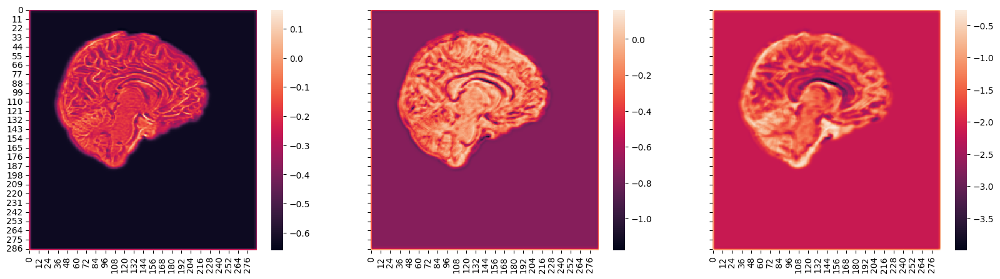

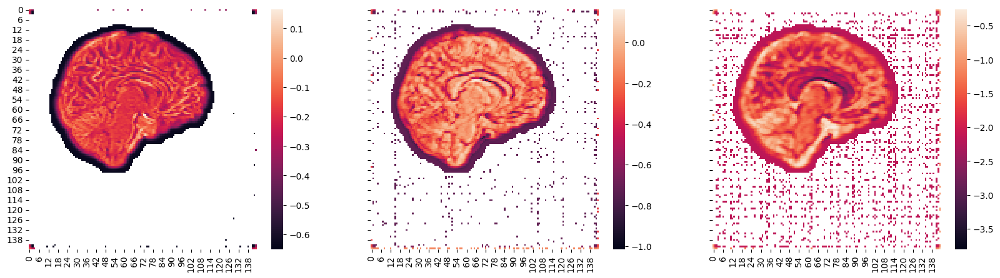

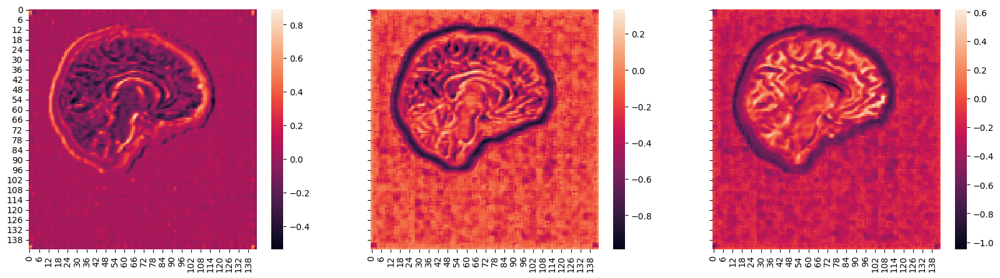

In [96]:
pool_1_0_input = pickle.load(open("/scratch/vinuyans/skips/embeddings/thresh10/axial_1_0_pool_input.pkl", "rb"))
print(pool_1_0_input.shape)

fig, axes = plt.subplots(1, 3, figsize=(20,5), sharey=True)
sns.heatmap(pool_1_0_input[0,10], ax=axes[0])
sns.heatmap(pool_1_0_input[0,30], ax=axes[1])
sns.heatmap(pool_1_0_input[0,50], ax=axes[2])

embed_1_0_bilinear = pickle.load(open("/scratch/vinuyans/skips/embeddings/thresh10/axial_1_0_pool.pkl", "rb"))
print(embed_1_0_bilinear.shape)

fig, axes = plt.subplots(1, 3, figsize=(20,5), sharey=True)
sns.heatmap(embed_1_0_bilinear[0,10], ax=axes[0])
sns.heatmap(embed_1_0_bilinear[0,30], ax=axes[1])
sns.heatmap(embed_1_0_bilinear[0,50], ax=axes[2])


embed_1_0_bilinear = pickle.load(open("/scratch/vinuyans/skips/embeddings/thresh10/axial_2_0_pool.pkl", "rb"))
print(embed_1_0_bilinear.shape)

fig, axes = plt.subplots(1, 3, figsize=(20,5), sharey=True)
sns.heatmap(embed_1_0_bilinear[0,10], ax=axes[0])
sns.heatmap(embed_1_0_bilinear[0,30], ax=axes[1])
sns.heatmap(embed_1_0_bilinear[0,50], ax=axes[2]);

torch.Size([2, 64, 288, 288])


<Axes: >

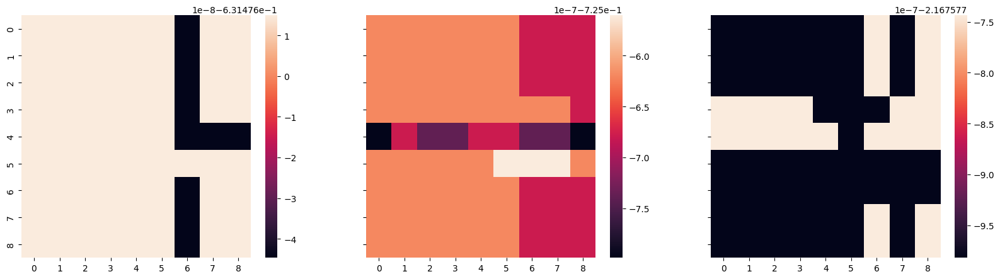

In [94]:
pool_1_0_input = pickle.load(open("/scratch/vinuyans/skips/embeddings/thresh10/axial_1_0_pool_input.pkl", "rb"))
print(pool_1_0_input.shape)

fig, axes = plt.subplots(1, 3, figsize=(20,5), sharey=True)
sns.heatmap(pool_1_0_input[0,10, 9:18, 9:18], ax=axes[0], )
sns.heatmap(pool_1_0_input[0,30, 9:18, 9:18], ax=axes[1], )
sns.heatmap(pool_1_0_input[0,50, 9:18, 9:18], ax=axes[2], )

In [18]:
print(len(set(pool_1_0_input[0,10, :50, :50].ravel().numpy())), pool_1_0_input[0,10, :50, :50].numel())
print(len(set(pool_1_0_input[0,30, :50, :50].ravel().numpy())), pool_1_0_input[0,30, :50, :50].numel())
print(len(set(pool_1_0_input[0,50, :50, :50].ravel().numpy())), pool_1_0_input[0,50, :50, :50].numel())

76 2500
97 2500
67 2500


torch.Size([1, 1, 25, 25])


<Axes: >

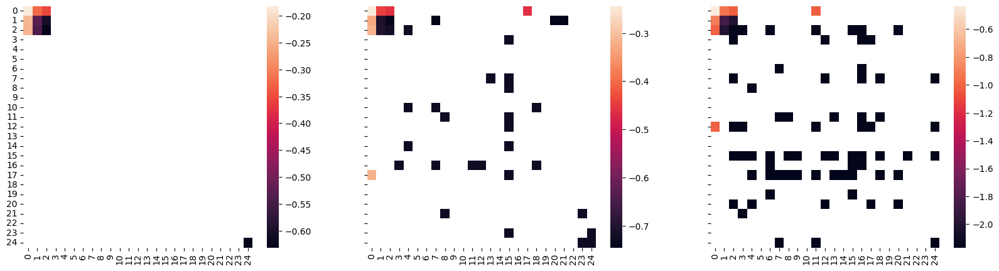

In [21]:
fig, axes = plt.subplots(1, 3, figsize=(20,5), sharey=True)

pool_x1_0, indices_x1 = NaNPool2d()(pool_1_0_input[:1, 10:11, :50, :50], (2, 2), (2, 2))
print(pool_x1_0.shape)

sns.heatmap(pool_x1_0.squeeze(), ax=axes[0])
pool_x1_0, indices_x1 = NaNPool2d()(pool_1_0_input[:1, 30:31, :50, :50], (2, 2), (2, 2))

sns.heatmap(pool_x1_0.squeeze(), ax=axes[1])

pool_x1_0, indices_x1 = NaNPool2d()(pool_1_0_input[:1, 50:51, :50, :50], (2, 2), (2, 2))
sns.heatmap(pool_x1_0.squeeze(), ax=axes[2])


**Apply NaNPooling and Convolution Across Different Thresholds**

In [5]:
# pool_x1_0, indices_x1 = NaNPool2d()(embed_1_0_bilinear[:1, 9:10, :50, :50], (2, 2), (2, 2))
pool_x1_0, indices_x1 = NaNPool2d()(pool_1_0_input[:1, 9:10, :50, :50], (2, 2), (2, 2))

conv0 = NaNConv2d(train=False,threshold=0.75, kernel=torch.randn((1,1,3,3)), stride=1, padding=1)(pool_x1_0)

print('Pooling shape', pool_x1_0.shape)
print('Conv shape', conv0.shape)


Pooling shape torch.Size([1, 1, 25, 25])
Conv shape torch.Size([1, 1, 25, 25])


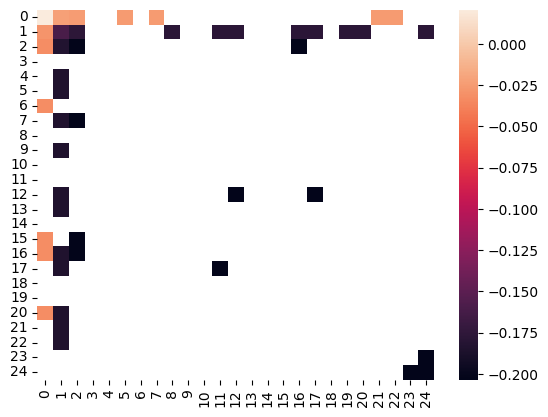

<Axes: >

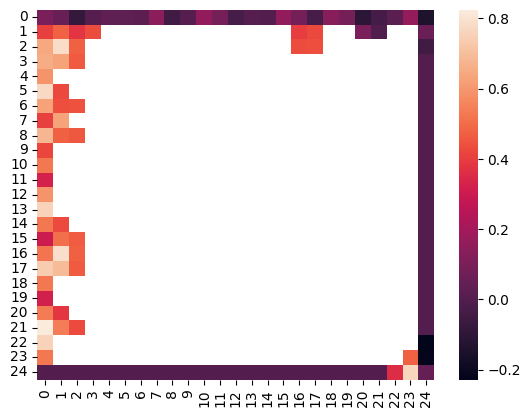

In [7]:
sns.heatmap(pool_x1_0.squeeze());
plt.show()


sns.heatmap(conv0.squeeze())



<Axes: >

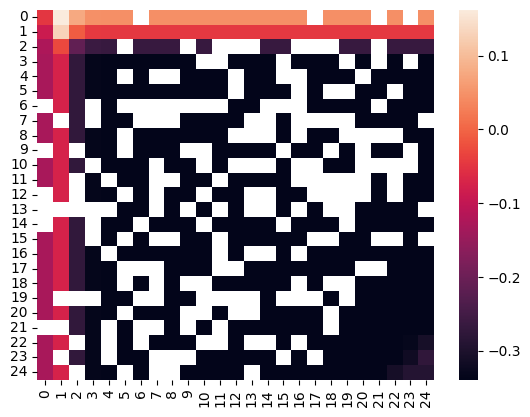

In [22]:
sns.heatmap(pool_x1_0.squeeze());


<Axes: >

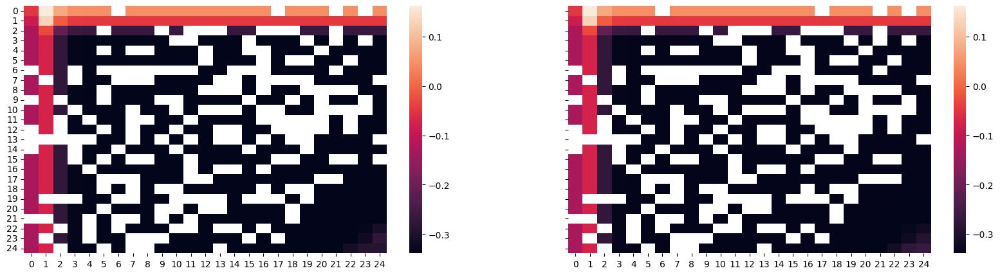

In [24]:
fig, axes = plt.subplots(1, 2, figsize=(20,5), sharey=True)

sns.heatmap(pool_x1_0.squeeze()[0], ax=axes[0])
sns.heatmap(pool_x1_0.squeeze()[1], ax=axes[1])


Threshold 0.75

<Axes: >

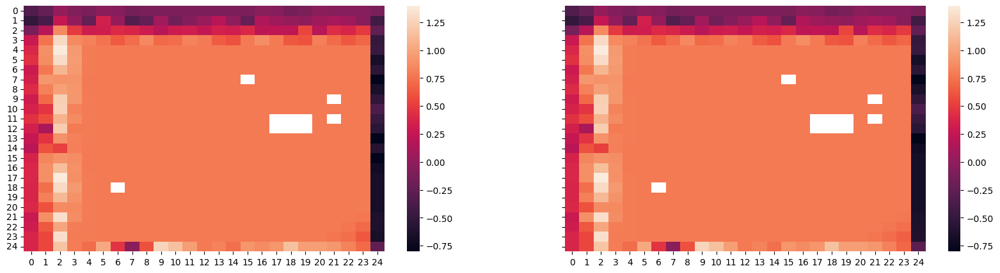

In [46]:
fig, axes = plt.subplots(1, 2, figsize=(20,5), sharey=True)

sns.heatmap(conv0.squeeze()[0], ax=axes[0])
sns.heatmap(conv0.squeeze()[1], ax=axes[1])


Threshold 1

<Axes: >

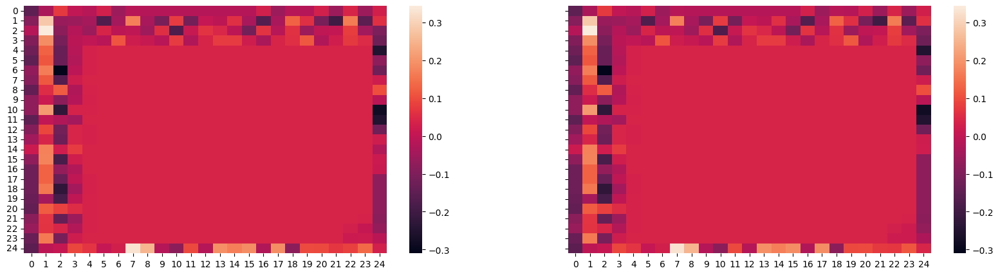

In [36]:
fig, axes = plt.subplots(1, 2, figsize=(20,5), sharey=True)

sns.heatmap(conv0.squeeze()[0], ax=axes[0])
sns.heatmap(conv0.squeeze()[1], ax=axes[1])


torch.Size([2, 64, 36, 36])
torch.Size([2, 64, 36, 36])


<Axes: >

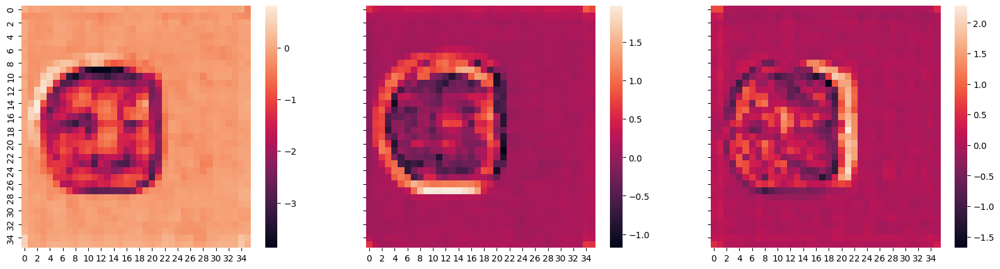

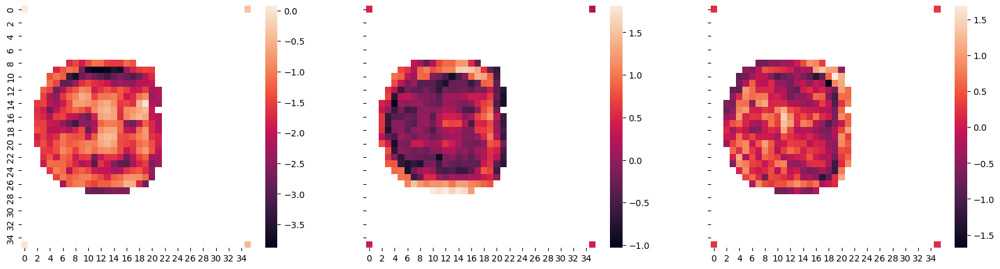

In [14]:
block_order = ['0_0', '1_0', '2_0', '3_0', '4_0', '5_0', '6_0',
               '0_1', '1_1', '2_1', '3_1', '4_1', '5_1',
               '0_2', '1_2', '2_2', '3_2', '4_2',
               '0_3', '1_3', '2_3', '3_3',
               '0_4', '1_4', '2_4',
               '0_5', '1_5',
               '0_6']


"""coronal_0_0_base_output.pkl          coronal_3_0_pool.pkl
coronal_0_0_bilinear.pkl             coronal_3_0_unpool.pkl
coronal_1_0_bilinear_v2.pkl          coronal_3_1_max_input.pkl
coronal_1_0_pool_indices.pkl         coronal_3_1_unpool.pkl
coronal_1_0_pool.pkl                 coronal_3_2_unpool.pkl
coronal_1_1_bilinear.pkl             coronal_3_3_unpool.pkl
coronal_1_1_max_input.pkl            coronal_4_0_pool_indices.pkl
coronal_1_2_bilinear.pkl             coronal_4_0_pool.pkl
coronal_1_2_max_input.pkl            coronal_4_0_unpool.pkl
coronal_1_3_bilinear_max_input.pkl   coronal_4_1_unpool.pkl
coronal_1_3_bilinear_max_output.pkl  coronal_4_2_unpool.pkl
coronal_1_3_bilinear.pkl             coronal_5_0_pool_indices.pkl
coronal_1_4_bilinear.pkl             coronal_5_0_pool.pkl
coronal_1_5_bilinear.pkl             coronal_5_0_unpool.pkl
coronal_2_0_pool_indices.pkl         coronal_5_1_unpool.pkl
coronal_2_0_pool.pkl                 coronal_6_0_unpool.pkl
coronal_2_0_unpool.pkl               coronal_denoised.pkl
coronal_2_1_max_input.pkl            coronal_y1.pkl
coronal_2_1_unpool.pkl               coronal_y2.pkl
coronal_2_2_max_input.pkl            coronal_y3.pkl
coronal_2_2_unpool.pkl               coronal_y4.pkl
coronal_2_3_unpool.pkl               coronal_y5.pkl
coronal_2_4_unpool.pkl               coronal_y6.pkl
coronal_3_0_pool_indices.pkl """

embed_1_0_bilinear = pickle.load(open(f"/scratch/vinuyans/skips/embeddings/thresh10/3_0_pool.pkl", "rb"))
print(embed_1_0_bilinear.shape)

fig, axes = plt.subplots(1, 3, figsize=(20,5), sharey=True)
sns.heatmap(embed_1_0_bilinear[0,10, :50, :50], ax=axes[0])
sns.heatmap(embed_1_0_bilinear[0,30], ax=axes[1])
sns.heatmap(embed_1_0_bilinear[0,50], ax=axes[2])


embed_1_0_bilinear = pickle.load(open(f"/scratch/vinuyans/skips/embeddings/thresh05/3_0_pool.pkl", "rb"))
print(embed_1_0_bilinear.shape)

fig, axes = plt.subplots(1, 3, figsize=(20,5), sharey=True)
sns.heatmap(embed_1_0_bilinear[0,10, :50, :50], ax=axes[0])
sns.heatmap(embed_1_0_bilinear[0,30], ax=axes[1])
sns.heatmap(embed_1_0_bilinear[0,50], ax=axes[2])


In [6]:
from nan_ops import NaNPool2d

# def __init__(self, max_threshold: int = 1, probabilistic: bool = False, nan_probability: Optional[float] = 0.8):

pool_x1_0, indices_x1 = NaNPool2d()(embed_1_0_bilinear[:1, 8:10], (2, 2), (2, 2))

pool_x1_0.shape

torch.Size([1, 2, 128, 128])

<Axes: >

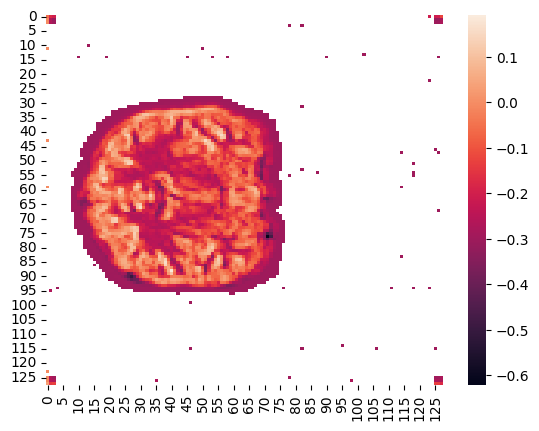

In [7]:
# fig, axes = plt.subplots(1, 3, figsize=(20,5), sharey=True)
sns.heatmap(pool_x1_0.squeeze()[0])
# sns.heatmap(embed_1_0_bilinear[0,30], ax=axes[1])
# sns.heatmap(embed_1_0_bilinear[0,50], ax=axes[2])

## SkipConv

In [2]:
def count_skipped_ops(filename):
    

    f = open(filename, 'r')
#     print(filename)

    skip_count = {}

    for line in f: 
        
        line = line.strip()
        if 'model loaded' in line:
               if line.split('model loaded')[0].strip() == 'First':
                    axis = 'axial'
                    skip_count[axis] = {}
               elif line.split('model loaded')[0].strip() == 'Second':
                  axis = 'coronal'
                  skip_count[axis] = {}
               elif line.split('model loaded')[0].strip() == 'Third':
                  axis = 'sagittal'
                  skip_count[axis] = {}    
          # views = {'First': 'axial', 'Second': 'coronal', 'Third': 'sagittal'}
        
        # Regex pattern
        pattern = r'(?:\d{1,2} \w{3}  \d{1,2} \d{2}:\d{2}:\d{2} \d{4}, )?(\d+_\d+): Conv1: (\d+)/(\d+), Conv2: (\d+)/(\d+), Conv3: (\d+)/(\d+)'
        
        match = re.search(pattern, line)
        if match:
          key = match.group(1)
          # if key == '6_0': print('here')
          skip_count[axis][key] = {
               'Conv1': int(match.group(2))/int(match.group(3)),
               'Conv2': int(match.group(4))/int(match.group(5)),
               'Conv3': int(match.group(6))/int(match.group(7))
          }
     
    return skip_count


block_order = ['0_0', '1_0', '2_0', '3_0', '4_0', '5_0', '6_0',
               '0_1', '1_1', '2_1', '3_1', '4_1', '5_1',
               '0_2', '1_2', '2_2', '3_2', '4_2',
               '0_3', '1_3', '2_3', '3_3',
               '0_4', '1_4', '2_4',
               '0_5', '1_5',
               '0_6']

# block_order = ['0_0',
#                '0_1', '1_0',
#                '0_2', '1_1', '2_0',
#                '0_3', '1_2', '2_1', '3_0',
#                '0_4', '1_3', '2_2', '3_1', '4_0',
#                '0_5', '1_4', '2_3', '3_2', '4_1', '5_0',
#                '0_6', '1_5', '2_4', '3_3', '4_2', '5_1', '6_0']

def aggregate_per_threshold(thresh, thresh_sub):

    sub_ratio = {thresh: {'coronal': {}, 'axial': {}, 'sagittal': {}} }


    for num, slice in enumerate(thresh_sub):
        # print(plane)
        # sub_ratio[:] = {}

        for plane in slice:

            sub_ratio[thresh][plane][num] = []

            # print(sub[plane])

            for block in block_order:
                sub_ratio[thresh][plane][num].append(np.mean(list(slice[plane][block].values())))
        
    return sub_ratio



# _ = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t1_{5}.out")


### Experimenting Across Epsilons

#### Raw Images

**Threshold 0.3**

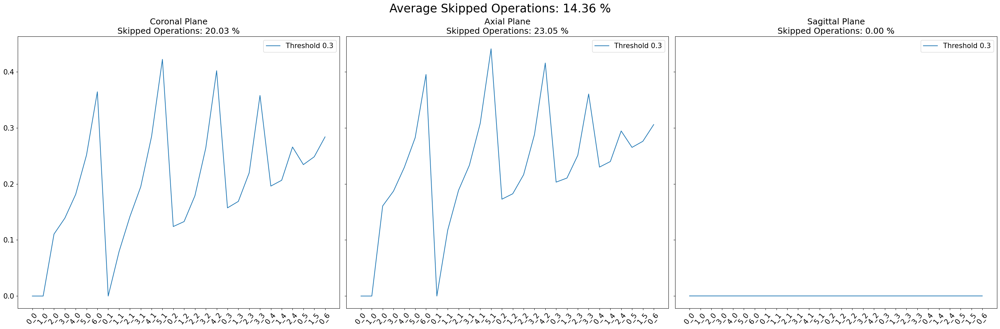

In [41]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.3_sub-0003002_ses-1_run-1_T1w.nii.gz_60.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.3', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['0.3']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['0.3'][plane].values()) for plane in sub_ratio['0.3'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


**Threshold 0.4 Epsilon 1e-7**

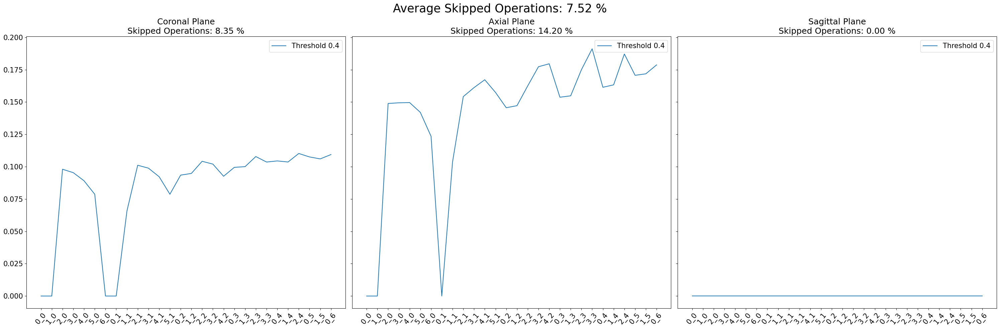

In [7]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.4_sub-0003002_ses-1_run-1_T1w.nii.gz_60_eps1e-7.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.4', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['0.4']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['0.4'][plane].values()) for plane in sub_ratio['0.4'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


**Threshold 0.4 Epsilon 1e-6**

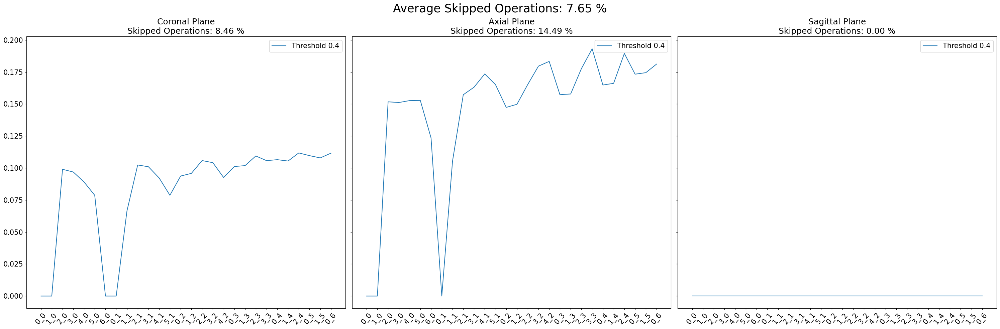

In [4]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.4_sub-0003002_ses-1_run-1_T1w.nii.gz_60.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.4', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['0.4']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['0.4'][plane].values()) for plane in sub_ratio['0.4'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


**Threshold 0.4 Epsilon 1e-5**

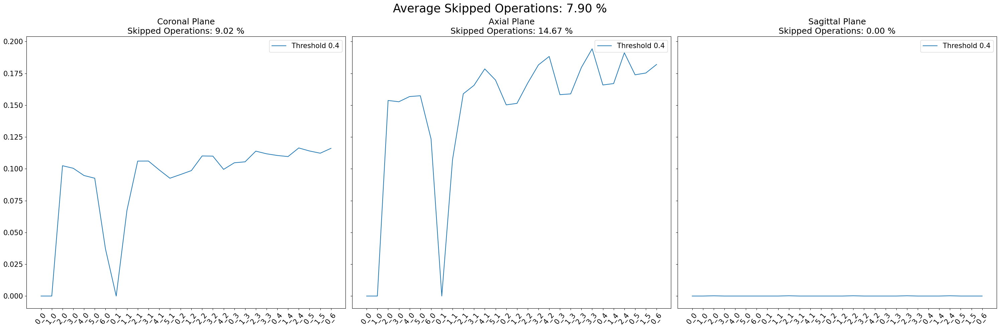

In [4]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.4_sub-0003002_ses-1_run-1_T1w.nii.gz_60_eps1e-5.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.4', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['0.4']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['0.4'][plane].values()) for plane in sub_ratio['0.4'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


**Threshold 0.5 Epsilon 1e-7**

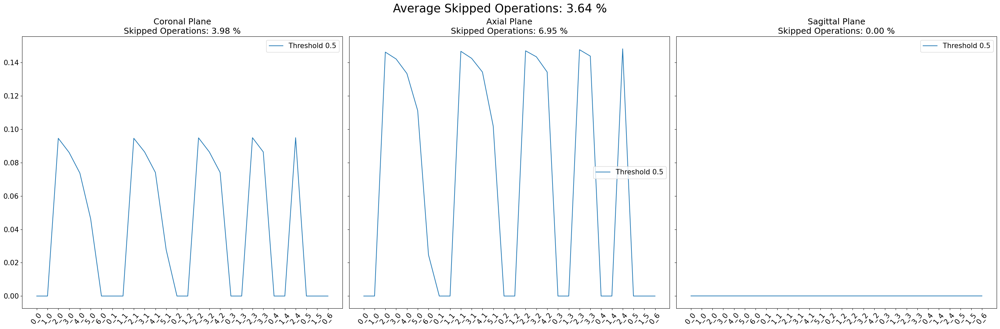

In [ ]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.5_sub-0003002_ses-1_run-1_T1w.nii.gz_60_eps1e-7.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.5', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['0.5']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['0.5'][plane].values()) for plane in sub_ratio['0.5'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


**Threshold 0.5 Epsilon 1e-6**

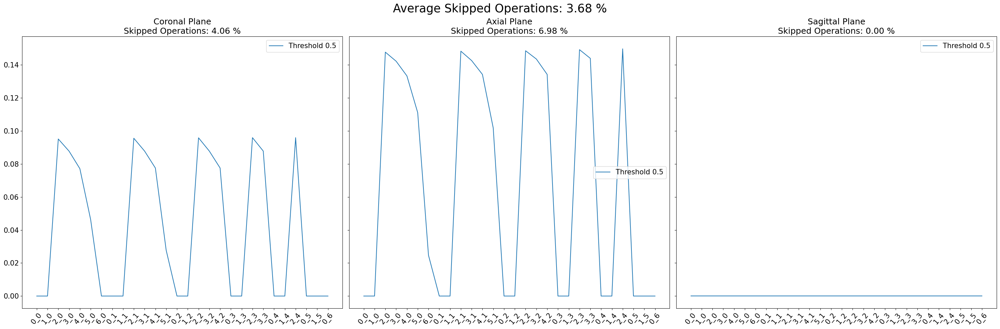

In [5]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.5_sub-0003002_ses-1_run-1_T1w.nii.gz_60_eps1e-6.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.5', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['0.5']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['0.5'][plane].values()) for plane in sub_ratio['0.5'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


**Threshold 0.5 Epsilon 1e-5**

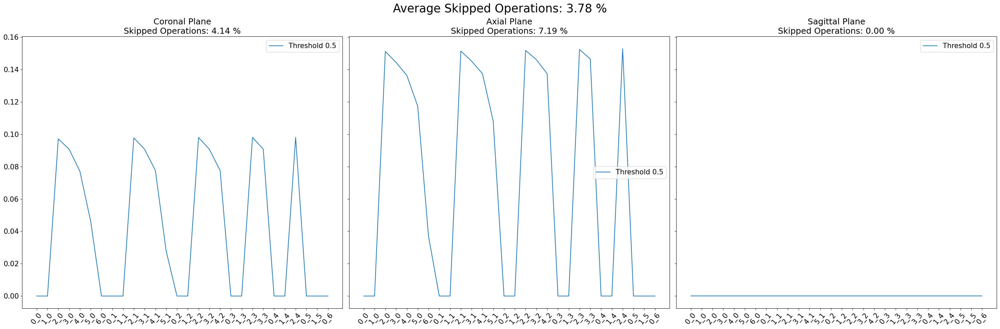

In [5]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.5_sub-0003002_ses-1_run-1_T1w.nii.gz_60_eps1e-5.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.5', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['0.5']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['0.5'][plane].values()) for plane in sub_ratio['0.5'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


**Threshold 0.75**

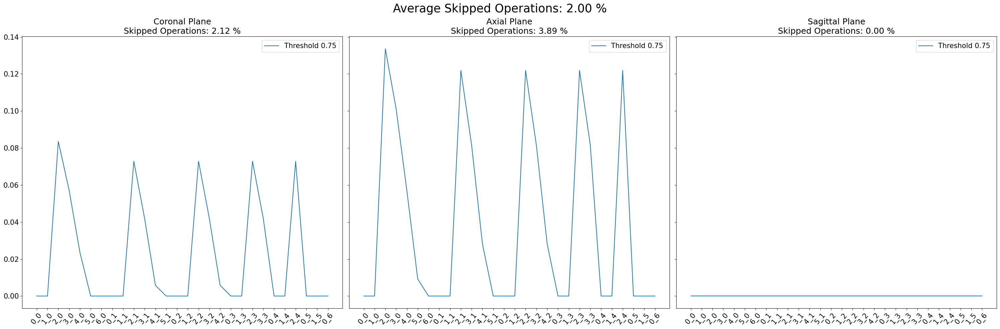

In [42]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.75_sub-0003002_ses-1_run-1_T1w.nii.gz_60.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.75', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['0.75']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['0.75'][plane].values()) for plane in sub_ratio['0.75'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


#### Processed

**Threshold 0.75 Epsilon=1e-7**

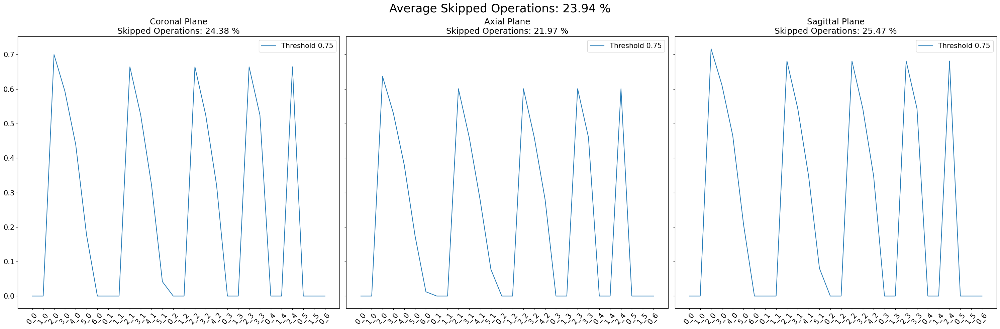

In [44]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.75_sub-0003002_embedding.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.75', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['0.75']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['0.75'][plane].values()) for plane in sub_ratio['0.75'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


**Threshold 1 Epsilon=1e-6**

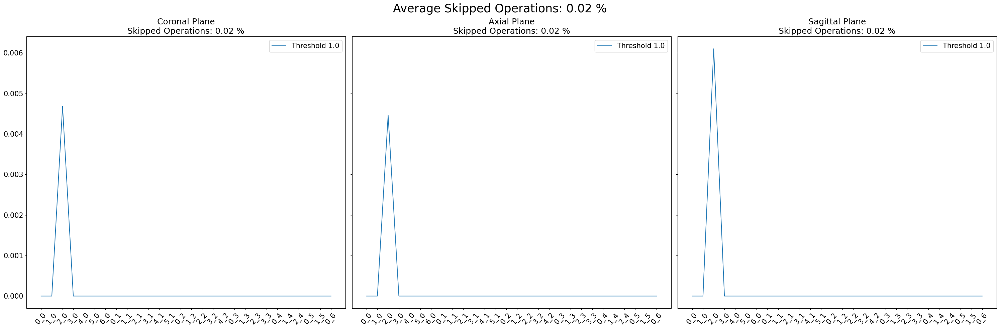

In [47]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t1.0_sub-0003002_60_ep1e-6.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('1.0', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['1.0']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['1.0'][plane].values()) for plane in sub_ratio['1.0'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


**Threshold 1.0 Epsilon=1e-5**

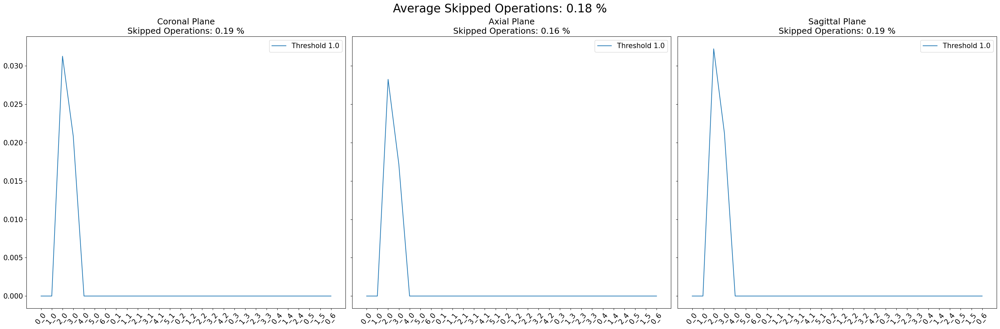

In [48]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t1.0_sub-0003002_60_ep1e-5.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('1.0', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['1.0']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['1.0'][plane].values()) for plane in sub_ratio['1.0'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


**Threshold 0.5**

In [49]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.5_sub-0003002_60.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.5', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['0.5']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['0.5'][plane].values()) for plane in sub_ratio['0.5'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


KeyError: '3_0'

### Final Visualizations

In [3]:
thresh1_sub = [count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t1.0_sub-0003002_{i}.out") for i in range(128)]
thresh075_sub = [count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.75_sub-0003002_{i}.out") for i in range(128)]
thresh05_sub = [count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.5_sub-0003002_{i}.out") for i in range(128)]

**Visualize Across Architectural Blocks**

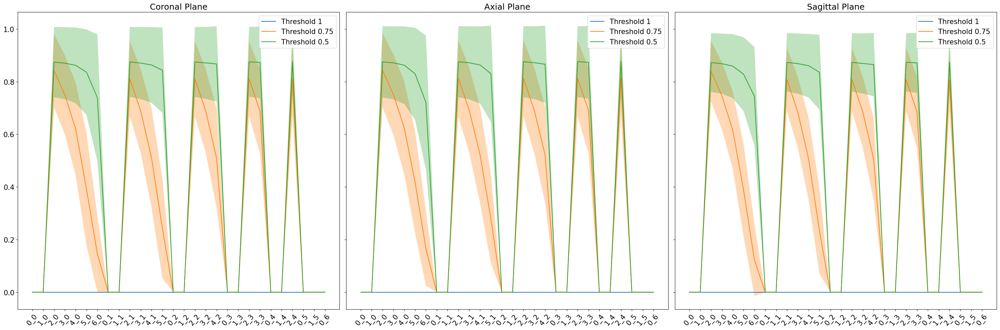

In [7]:
# sub_ratio = {'1': {'coronal': {}, 'axial': {}, 'sagittal': {}}, '0.5': {'coronal': {}, 'axial': {}, 'sagittal': {}} }
sub_ratio = {}

sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.75', thresh075_sub))
sub_ratio.update(aggregate_per_threshold('0.5', thresh05_sub))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['1', '0.75', '0.5']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.tight_layout()


**Visualize Across Brain Slices**

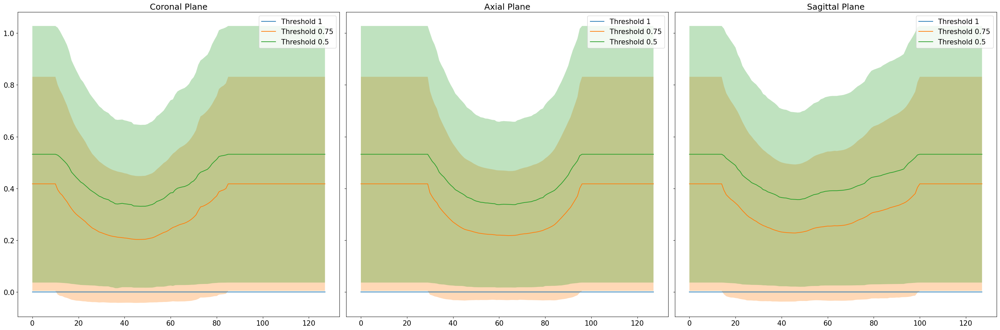

In [8]:
sub_ratio = {}

sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.75', thresh075_sub))
sub_ratio.update(aggregate_per_threshold('0.5', thresh05_sub))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):

    for thresh in ['1', '0.75', '0.5']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=1)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=1)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)  

plt.tight_layout()


## SNR

### Peak SNR

* In order to calculate SNR we need to aggregate the slices
```
apptainer shell --bind /scratch/ine5/fs_subject_ieee/:/data --bind /scratch/vinuyans/skips/:/skips --bind /scratch/vinuyans/fondue:/FONDUE/ fondue_ieee.sif
python /FONDUE/aggregate.py --in_name /data/sub-0003002/norm.nii.gz --out_name /skips/sub-0003002/thresh05/sub-0003002_thresh05_aggr.nii.gz --no_cuda --sub_root /skips/sub-0003002/thresh05

```

**Calculation of peak SNR** 

* Calculate PSNR across raw slices + aggregated final FONDUE output
* For aggregated output we need to normalize the denoised images in order to match how FONDUE authors calculated PSNR + we use their method of loading images (minor differences in calculated PSNR due to this)

In [2]:
# class PSNR:
#     """Peak Signal to Noise Ratio
#     img1 and img2 have range [0, 255]"""

#     def __init__(self):
#         self.name = "PSNR"

#     @staticmethod
#     def __call__(img1, img2, device):
#         mse = torch.nn.MSELoss()
#         a = img1.to(device, dtype = torch.float32)
#         b = img2.to(device, dtype = torch.float32)
#         mse_total = mse(a,b)
#         psnr = 20 * torch.log10(1.0 / torch.sqrt(mse_total))
#         return psnr

def calculate_psnr(img1, img2):
    # Ensure the images have the same shape
    assert img1.shape == img2.shape, "Input images must have the same dimensions"
    
    # Calculate MSE
    mse = np.mean((img1 - img2) ** 2)
    
    # Avoid division by zero
    if mse == 0:
        return float('inf'), None  # Identical images would have infinite PSNR

    # Calculate the maximum intensity of the original image
    max_intensity = np.max(img1)
    print(max_intensity)

    # Calculate PSNR
    psnr = 10 * np.log10((max_intensity ** 2) / mse)
    return psnr

def normalize(slice):
    min_val = slice.min()
    max_val = slice.max()

    # Check if max equals min to avoid division by zero
    if max_val != min_val:
        slice = (slice - min_val) / (max_val - min_val)
    else:
        # All values are the same, assign a constant value, e.g., 0
        slice = torch.zeros_like(slice)

    return slice

def getvol(path_denoised):
    img_denoised = load_and_conform_image(path_denoised) #Read the image
    img_denoised = np.nan_to_num(img_denoised)
    # print(img_denoised.min(), img_denoised.max())
    img_denoised = 255.0*(img_denoised - img_denoised.min()) / \
        (img_denoised.max() - img_denoised.min())
    img_denoised = img_denoised.astype(np.single)
    return img_denoised

def smooth_and_binarize_mask(volume, sigma=1.0, threshold=0.1, dilation_iterations=1):
    """
    Smooth a 3D array, threshold non-zero values, and binarize the result.

    Parameters:
    - volume: 3D NumPy array to process
    - sigma: float, standard deviation for Gaussian kernel (default=1.0)
    - threshold: float, threshold value for binarization (default=0.1)
    
    Returns:
    - binary_mask: 3D binary mask as a NumPy array
    """

    # Step 1: Apply Gaussian smoothing to the input volume
    smoothed_volume = gaussian_filter(volume, sigma=sigma)
    
    # Step 2: Threshold values that are not zero
    thresholded_volume = np.where(smoothed_volume > threshold, 1, 0)
    
    # Step 3: Return the binary mask
    binary_mask = (thresholded_volume > 0).astype(np.uint8)
    
    # Step 4: Apply binary dilation to close any holes
    dilated_mask = binary_dilation(binary_mask, iterations=dilation_iterations).astype(np.uint8)
    
    return dilated_mask

def peak_snr_across_slices_aggregated(filedir, thresholds):

    fig, axes = plt.subplots(1, 3, figsize=(25,5), sharey=True)
    psnr = PSNR()
    snr = {}

    for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
    # for num, plane in enumerate(['coronal']):

        snr[plane] = {}
        
        for thresh in thresholds:
            # snr_slices1 = []
            snr_slices = []
            snr[plane][thresh] = []

            # mask_template = getvol('/scratch/vinuyans/skips/sub-0003002/groundtruth.nii')
            mask = smooth_and_binarize_mask(nib.load('/scratch/vinuyans/skips/sub-0003002/groundtruth.nii').get_fdata(), sigma=0.5, threshold=0.)


            # if masked:
            #     ieee_img = getvol('/scratch/vinuyans/skips/ieee/sub-0003002/sub-0003002_ieee_whole_mask.nii.gz')
            #     thresh_img = getvol(f'/scratch/vinuyans/skips/sub-0003002/thresh{thresh}/sub-0003002_thresh{thresh}_aggr_masked.nii.gz')
            # else:
            ieee_img = getvol('/scratch/vinuyans/skips/sub-0003002/groundtruth.nii')
            if thresh == 'ieee':
                thresh_img = getvol(f'/scratch/vinuyans/skips/ieee/sub-0003002/sub-0003002_ieee_whole.nii.gz')
            else:
                thresh_img = getvol(f'/scratch/vinuyans/skips/sub-0003002/thresh{thresh}/sub-0003002_thresh{thresh}_aggr.nii.gz')


            #get mask
            # mask = np.where(mask_template == 0, False, True).squeeze()

            for i in range(256):

                # ieee_slice = pickle.load(open(f"{filedir}/ieee/{plane}/processed/{i}_slice.pkl", "rb")) #.squeeze()[0].numpy()      
                # thresh_slice = pickle.load(open(f"{filedir}/thresh{thresh}/{plane}/processed/{i}_slice.pkl", "rb")) #.squeeze()[0].numpy()                  
                if plane == 'axial':
                    ieee_slice = ieee_img[i]
                    thresh_slice = thresh_img[i]
                    mask_slice = mask[i]
                elif plane == 'sagittal':
                    ieee_slice = ieee_img[:, :, i]
                    thresh_slice = thresh_img[:, :, i]
                    mask_slice = mask[:, :, i]
                else:
                    ieee_slice = ieee_img[:, i, :]
                    thresh_slice = thresh_img[:, i, :]
                    mask_slice = mask[:, i, :]

                # ieee_slice = np.nan_to_num(ieee_slice) 
                # thresh_slice = np.nan_to_num(thresh_slice)

                ieee_slice = torch.from_numpy(ieee_slice).to('cpu').type(torch.float16) 
                thresh_slice = torch.from_numpy(thresh_slice).to('cpu').type(torch.float16) 

                ieee_slice = (ieee_slice - ieee_slice.min()) / (ieee_slice.max() - ieee_slice.min())
                thresh_slice = (thresh_slice - thresh_slice.min()) / (thresh_slice.max() - thresh_slice.min())
                # print(thresh_slice.max())

                output = psnr(ieee_slice[mask_slice != False], thresh_slice[mask_slice != False], 'cpu').item()

                    
                # snr_slices1.append(calculate_psnr(ieee_slice, thresh_slice))
                # snr_slices.append(psnr(ieee_slice, thresh_slice, 'cpu').item())
                snr_slices.append( output )

            snr[plane][thresh] = snr_slices
            if thresh == 'ieee':
                axes[num].plot(snr_slices, label=f'Default')
            else:
                axes[num].plot(snr_slices, label=f'Threshold {thresh}')
            axes[num].set_xlim(1,256)

        axes[num].legend(fontsize=15)
        axes[num].set_title(plane.title(),fontsize=18)
    axes[0].set_ylabel('PSNR (dB)', fontsize=15)
    plt.tight_layout()

    return snr

def peak_snr_across_slices_unmerged(filedir):

    fig, axes = plt.subplots(1, 3, figsize=(25,5), sharey=True)
    psnr = PSNR()



    for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
        
        for thresh in ['1', '05', '075']:
            snr_slices = []

            for i in range(128):

                ieee_slice = pickle.load(open(f"{filedir}/ieee/{plane}/processed/{i}_slice.pkl", "rb")) #.squeeze()[0].numpy()               
                thresh_slice = pickle.load(open(f"{filedir}/thresh{thresh}/{plane}/processed/{i}_slice.pkl", "rb")) #.squeeze()[0].numpy()                  
                    
                #Create MASK FROM IEEE

                # snr_slices.append(calculate_psnr(ieee_slice, thresh_slice))
                snr_slices.append(psnr(ieee_slice, thresh_slice, 'cpu'))

            if thresh == 'ieee': 
                axes[num].plot(snr_slices, label=f'Default')            
            else:
                axes[num].plot(snr_slices, label=f'Threshold {thresh}')
        axes[num].legend()
        axes[num].set_title(plane.title())
    axes[0].set_ylabel('PSNR (dB)')
    plt.tight_layout()


**PSNR Across Normalized Masked Aggregated Slices**

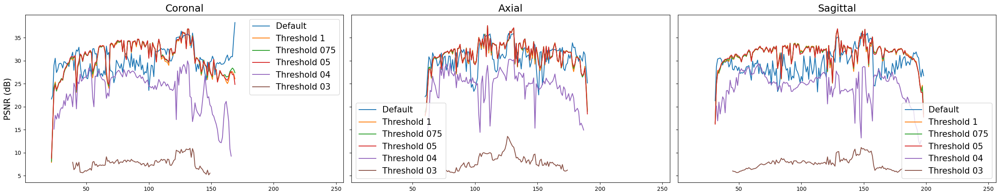

In [3]:
snr_mask = peak_snr_across_slices_aggregated("/scratch/vinuyans/skips/sub-0003002", thresholds=['ieee', '1', '075', '05', '04','03'])

**OLD Results**

'\nValues above 30 indicate similar slices\nBackground is forced to 0 as original output is NaN/inf due to normalization and is not displayed or else\n'

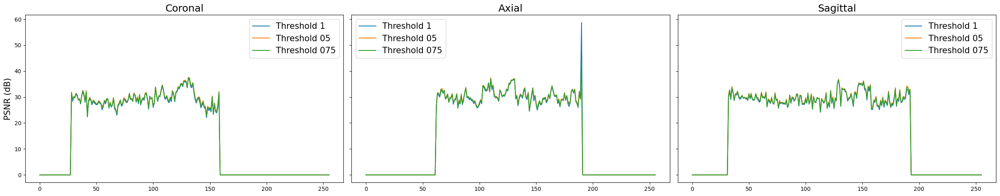

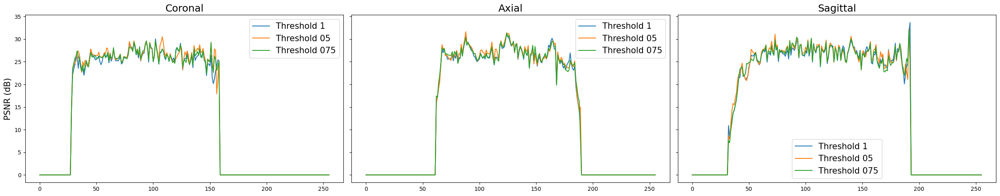

In [3]:
snr_nomask = peak_snr_across_slices_aggregated("/scratch/vinuyans/skips/sub-0003002", masked=False)
snr_mask = peak_snr_across_slices_aggregated("/scratch/vinuyans/skips/sub-0003002", masked=True)

"""
Values above 30 indicate similar slices
Background is forced to 0 as original output is NaN/inf due to normalization and is not displayed or else
"""

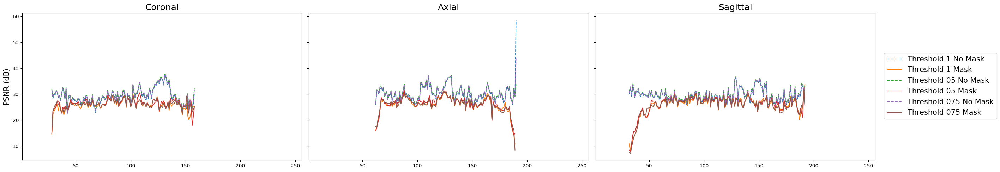

In [6]:
fig, axes = plt.subplots(1, 3, figsize=(25,5), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
    for thresh in snr_nomask[plane].keys():

        axes[num].plot(snr_nomask[plane][thresh], linestyle='dashed', label=f'Threshold {thresh} No Mask')
        axes[num].plot(snr_mask[plane][thresh], label=f'Threshold {thresh} Mask')

    # axes[num].legend(fontsize=15)
    axes[num].set_title(plane.title(),fontsize=18)
    axes[num].set_xlim(1,256)
axes[0].set_ylabel('PSNR (dB)', fontsize=15)

# Gather unique handles and labels from subplots
handles, labels = [], []
for ax in axes:
    for handle, label in zip(*ax.get_legend_handles_labels()):
        if label not in labels:
            handles.append(handle)
            labels.append(label)

# Create a single legend outside the plot using the unique handles and labels
fig.legend( handles, labels, fontsize=15, loc='center left', bbox_to_anchor=(1, 0.5))

# fig.legend(fontsize=15, loc='center left', bbox_to_anchor=(1, 0.5), title="Legend")

plt.tight_layout();


In [5]:
pickle.dump(snr_nomask, open('fondue_psnr_nomask.pkl', 'wb'))
pickle.dump(snr_mask, open('fondue_psnr_mask.pkl', 'wb'))

**PSNR Across Unmerged Slices**

"\nValues above 30 indicate similar slices\nThreshold 1 could be so different because despite NaNs being introduced by NaNPooling they weren't utilized by NaNConv due to the lenient threshold value thus only serving\nto provide variance in the final result"

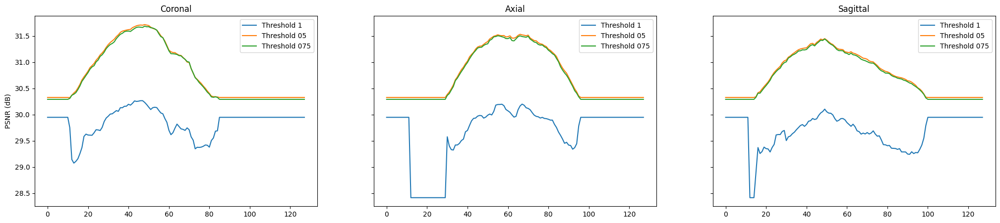

In [46]:
peak_snr_across_slices_unmerged("/scratch/vinuyans/skips/sub-0003002")
"""
Values above 30 indicate similar slices
Threshold 1 could be so different because despite NaNs being introduced by NaNPooling they weren't utilized by NaNConv due to the lenient threshold value thus only serving
to provide variance in the final result"""

### Local SNR

In [7]:
def replace_nan_with_nearest(image):
    """
    Replaces NaN values with the nearest non-NaN neighbor.
    
    Parameters:
    - image: 2D NumPy array, the image with potential NaN values.
    
    Returns:
    - image_filled: 2D NumPy array, the image with NaNs replaced by nearest neighbors.
    """
    # Mask to identify NaNs
    nan_mask = np.isnan(image)
    
    # Fill NaNs with a large value temporarily to apply a median filter
    image_filled = image.copy()
    image_filled[nan_mask] = np.nanmedian(image)

    # Apply nearest-neighbor interpolation to fill NaNs
    image_filled = ndimage.generic_filter(image_filled, np.nanmedian, size=3, mode='nearest')

    return image_filled


def calculate_local_snr(image, patch_size=3):
    """
    Calculate the local SNR of a 2D brain slice image, with NaNs replaced by nearest neighbors.
    
    Parameters:
    - image: 2D NumPy array, the brain slice image
    - patch_size: int, the size of the patches to divide the image into
    
    Returns:
    - snr_map: 2D NumPy array, the local SNR values with NaNs propagated.
    """
    # Ensure the image is a 2D array
    if len(image.shape) != 2:
        raise ValueError("Input image must be a 2D array.")
    
    # Replace NaNs with nearest neighbors
    image_filled = replace_nan_with_nearest(image)
    
    # Calculate local mean
    local_mean = ndimage.uniform_filter(image_filled, size=patch_size)
    
    # Calculate local squared mean
    local_sq_mean = ndimage.uniform_filter(image_filled**2, size=patch_size)
    
    # Calculate local variance (E[X^2] - (E[X])^2)
    local_variance = local_sq_mean - local_mean**2
    
    # Calculate local standard deviation
    local_std = np.sqrt(local_variance)
    
    # Avoid division by zero
    local_std[local_std == 0] = np.finfo(float).eps
    
    # Calculate local SNR (mean / std)
    snr_map = local_mean / local_std
    
    return np.abs(snr_map)


def calculate_local_snr_nonan(image, patch_size=3):
    """
    Calculate the local SNR of a 2D brain slice image using scipy.ndimage.
    
    Parameters:
    - image: 2D NumPy array, the brain slice image
    - patch_size: int, the size of the patches to divide the image into
    
    Returns:
    - snr_map: 2D NumPy array, the local SNR values
    """
    # Ensure the image is a 2D array
    if len(image.shape) != 2:
        raise ValueError("Input image must be a 2D array.")
    # Calculate local mean
    local_mean = ndimage.uniform_filter(image, size=patch_size)
    
    # Calculate local squared mean
    local_sq_mean = ndimage.uniform_filter(image**2, size=patch_size)
    
    # Calculate local variance (E[X^2] - (E[X])^2)
    local_variance = local_sq_mean - local_mean**2
    
    # Calculate local standard deviation
    local_std = np.sqrt(local_variance)
    
    # Avoid division by zero
    local_std[local_std == 0] = np.finfo(float).eps
    
    # Calculate local SNR (mean / std)
    snr_map = local_mean / local_std
    
    return np.abs(snr_map)


In [8]:
ieee_map = {}

for plane in ['axial', 'coronal', 'sagittal']:
    ieee_map[plane] = {}
    img = pickle.load(open(f'/scratch/vinuyans/skips/sub-0003002/ieee/{plane}/raw/60_slice.pkl', 'rb')).squeeze()
    # print(img.shape)
    snr_map0 = calculate_local_snr(img[0].numpy())
    snr_map1 = calculate_local_snr(img[1].numpy())
    ieee_map[plane] = {0: snr_map0, 1: snr_map1}

**Threshold 0.75**

/tmp/ipykernel_1029471/4050544515.py:52: RuntimeWarning: invalid value encountered in sqrt
  local_std = np.sqrt(local_variance)


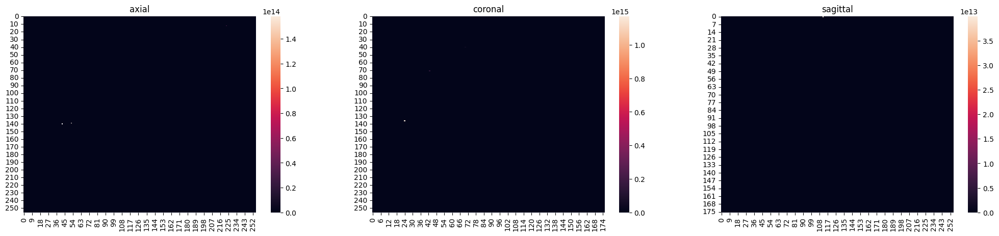

In [9]:
snr_map = {}

for plane in ['axial', 'coronal', 'sagittal']:
    snr_map[plane] = {}
    img = pickle.load(open(f'/scratch/vinuyans/skips/sub-0003002/thresh075/{plane}/raw/60_slice.pkl', 'rb')).squeeze()
    # print(img.shape)
    snr_map0 = calculate_local_snr(img[0].numpy())
    snr_map1 = calculate_local_snr(img[1].numpy())
    snr_map[plane] = {0: snr_map0, 1: snr_map1}

fig, axes = plt.subplots(1, 3, figsize=(25,5))
for num, plane in enumerate(['axial', 'coronal', 'sagittal']):
    gc = sns.heatmap(snr_map[plane][0], ax=axes[num])
    gc.set_title(plane)


/tmp/ipykernel_1029471/3951960701.py:3: RuntimeWarning: divide by zero encountered in divide
  diff = np.abs((ieee_map[plane][0] - snr_map[plane][0]) / ieee_map[plane][0] )
/tmp/ipykernel_1029471/3951960701.py:3: RuntimeWarning: divide by zero encountered in divide
  diff = np.abs((ieee_map[plane][0] - snr_map[plane][0]) / ieee_map[plane][0] )
/tmp/ipykernel_1029471/3951960701.py:3: RuntimeWarning: invalid value encountered in divide
  diff = np.abs((ieee_map[plane][0] - snr_map[plane][0]) / ieee_map[plane][0] )
/tmp/ipykernel_1029471/3951960701.py:5: RuntimeWarning: divide by zero encountered in divide
  diff = np.abs((ieee_map[plane][1] - snr_map[plane][1]) / ieee_map[plane][1] )
/tmp/ipykernel_1029471/3951960701.py:5: RuntimeWarning: invalid value encountered in divide
  diff = np.abs((ieee_map[plane][1] - snr_map[plane][1]) / ieee_map[plane][1] )
/tmp/ipykernel_1029471/3951960701.py:3: RuntimeWarning: divide by zero encountered in divide
  diff = np.abs((ieee_map[plane][0] - snr_ma

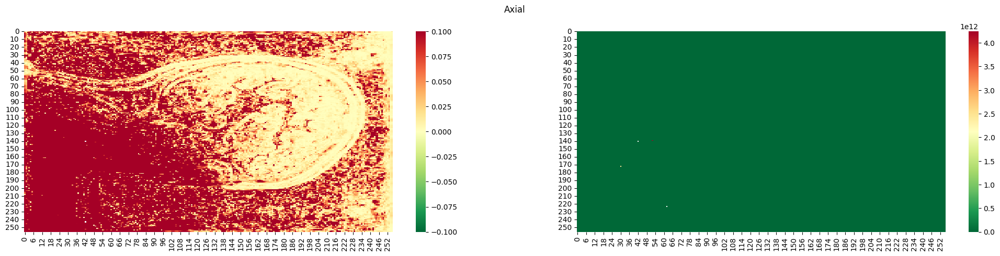

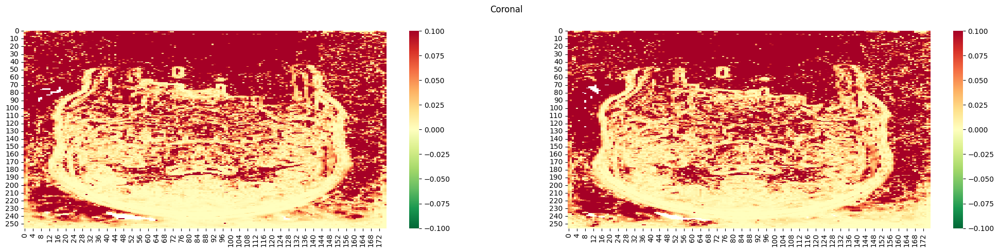

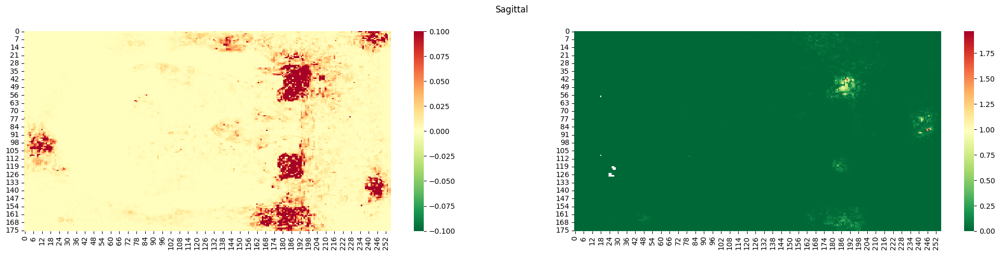

In [12]:
for plane in ['axial', 'coronal', 'sagittal']:
    fig, axes = plt.subplots(1, 2, figsize=(25,5))
    diff = np.abs((ieee_map[plane][0] - snr_map[plane][0]) / ieee_map[plane][0] )
    gc = sns.heatmap(diff, ax=axes[0], cmap='RdYlGn_r')
    diff = np.abs((ieee_map[plane][1] - snr_map[plane][1]) / ieee_map[plane][1] )
    gc = sns.heatmap(diff, ax=axes[1],  cmap='RdYlGn_r')
    plt.suptitle(f'{plane.title()}')


**Threshold 0.5**

/tmp/ipykernel_548447/4050544515.py:52: RuntimeWarning: invalid value encountered in sqrt
  local_std = np.sqrt(local_variance)


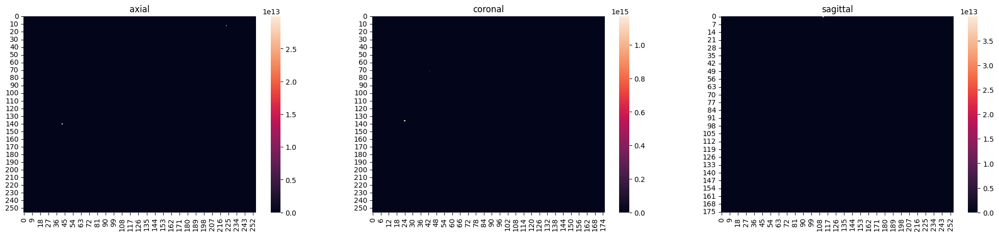

In [36]:
snr_map = {}

for plane in ['axial', 'coronal', 'sagittal']:
    snr_map[plane] = {}
    img = pickle.load(open(f'/scratch/vinuyans/skips/sub-0003002/thresh05/{plane}/raw/60_slice.pkl', 'rb')).squeeze()
    # print(img.shape)
    snr_map0 = calculate_local_snr(img[0].numpy())
    snr_map1 = calculate_local_snr(img[1].numpy())
    snr_map[plane] = {0: snr_map0, 1: snr_map1}

fig, axes = plt.subplots(1, 3, figsize=(25,5))
for num, plane in enumerate(['axial', 'coronal', 'sagittal']):
    gc = sns.heatmap(snr_map[plane][0], ax=axes[num])
    gc.set_title(plane)


/tmp/ipykernel_548447/359527291.py:3: RuntimeWarning: divide by zero encountered in divide
  diff = np.abs((ieee_map[plane][0] - snr_map[plane][0]) / ieee_map[plane][0] )
/tmp/ipykernel_548447/359527291.py:3: RuntimeWarning: divide by zero encountered in divide
  diff = np.abs((ieee_map[plane][0] - snr_map[plane][0]) / ieee_map[plane][0] )
/tmp/ipykernel_548447/359527291.py:3: RuntimeWarning: invalid value encountered in divide
  diff = np.abs((ieee_map[plane][0] - snr_map[plane][0]) / ieee_map[plane][0] )
/tmp/ipykernel_548447/359527291.py:5: RuntimeWarning: divide by zero encountered in divide
  diff = np.abs((ieee_map[plane][1] - snr_map[plane][1]) / ieee_map[plane][1] )
/tmp/ipykernel_548447/359527291.py:5: RuntimeWarning: invalid value encountered in divide
  diff = np.abs((ieee_map[plane][1] - snr_map[plane][1]) / ieee_map[plane][1] )
/tmp/ipykernel_548447/359527291.py:3: RuntimeWarning: divide by zero encountered in divide
  diff = np.abs((ieee_map[plane][0] - snr_map[plane][0])

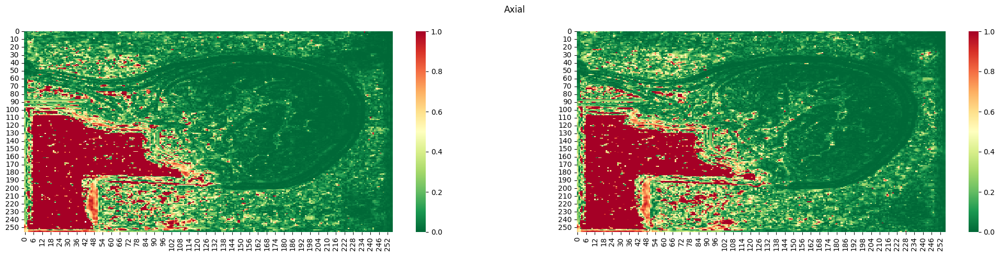

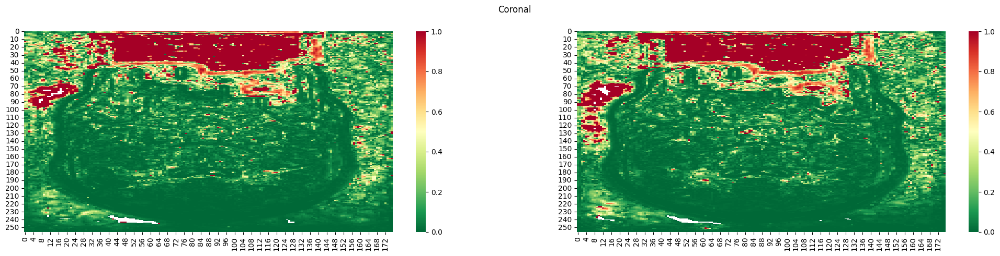

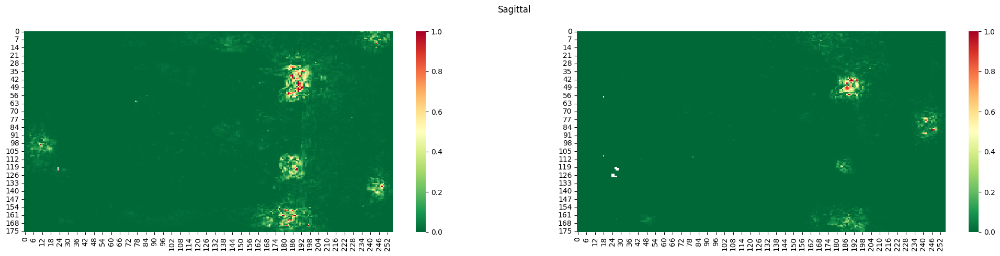

In [37]:
for plane in ['axial', 'coronal', 'sagittal']:
    fig, axes = plt.subplots(1, 2, figsize=(25,5))
    diff = np.abs((ieee_map[plane][0] - snr_map[plane][0]) / ieee_map[plane][0] )
    gc = sns.heatmap(diff, ax=axes[0], vmax=1, vmin=0, cmap='RdYlGn_r')
    diff = np.abs((ieee_map[plane][1] - snr_map[plane][1]) / ieee_map[plane][1] )
    gc = sns.heatmap(diff, ax=axes[1], vmax=1, vmin=0, cmap='RdYlGn_r')
    plt.suptitle(f'{plane.title()}')

**Threshold 0.4**

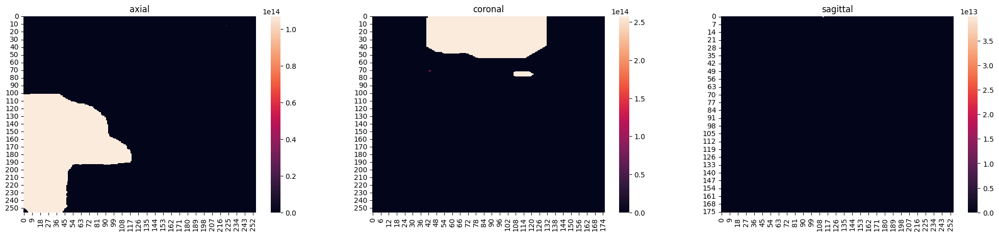

In [38]:
snr_map = {}

for plane in ['axial', 'coronal', 'sagittal']:
    snr_map[plane] = {}
    img = pickle.load(open(f'/scratch/vinuyans/skips/sub-0003002/thresh04/{plane}/raw/60_slice.pkl', 'rb')).squeeze()
    # print(img.shape)
    snr_map0 = calculate_local_snr(img[0].numpy())
    snr_map1 = calculate_local_snr(img[1].numpy())
    snr_map[plane] = {0: snr_map0, 1: snr_map1}

fig, axes = plt.subplots(1, 3, figsize=(25,5))
for num, plane in enumerate(['axial', 'coronal', 'sagittal']):
    gc = sns.heatmap(snr_map[plane][0], ax=axes[num])
    gc.set_title(plane)


/tmp/ipykernel_548447/359527291.py:3: RuntimeWarning: divide by zero encountered in divide
  diff = np.abs((ieee_map[plane][0] - snr_map[plane][0]) / ieee_map[plane][0] )
/tmp/ipykernel_548447/359527291.py:3: RuntimeWarning: divide by zero encountered in divide
  diff = np.abs((ieee_map[plane][0] - snr_map[plane][0]) / ieee_map[plane][0] )
/tmp/ipykernel_548447/359527291.py:3: RuntimeWarning: invalid value encountered in divide
  diff = np.abs((ieee_map[plane][0] - snr_map[plane][0]) / ieee_map[plane][0] )
/tmp/ipykernel_548447/359527291.py:5: RuntimeWarning: divide by zero encountered in divide
  diff = np.abs((ieee_map[plane][1] - snr_map[plane][1]) / ieee_map[plane][1] )
/tmp/ipykernel_548447/359527291.py:5: RuntimeWarning: invalid value encountered in divide
  diff = np.abs((ieee_map[plane][1] - snr_map[plane][1]) / ieee_map[plane][1] )
/tmp/ipykernel_548447/359527291.py:3: RuntimeWarning: divide by zero encountered in divide
  diff = np.abs((ieee_map[plane][0] - snr_map[plane][0])

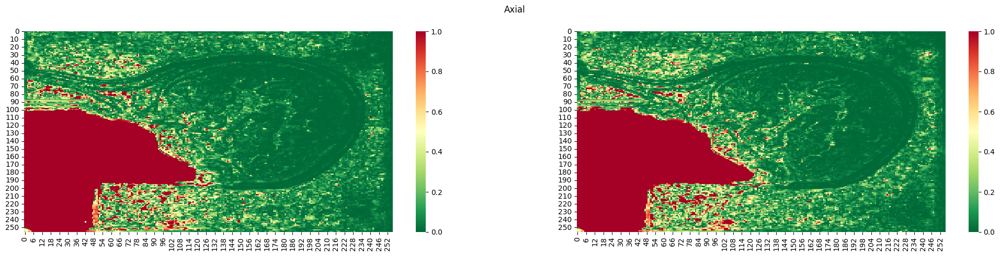

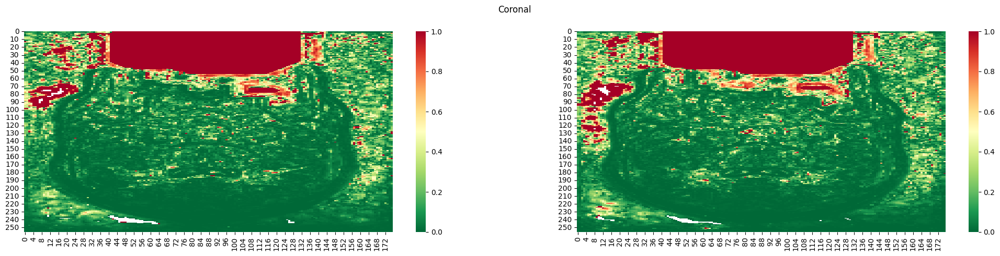

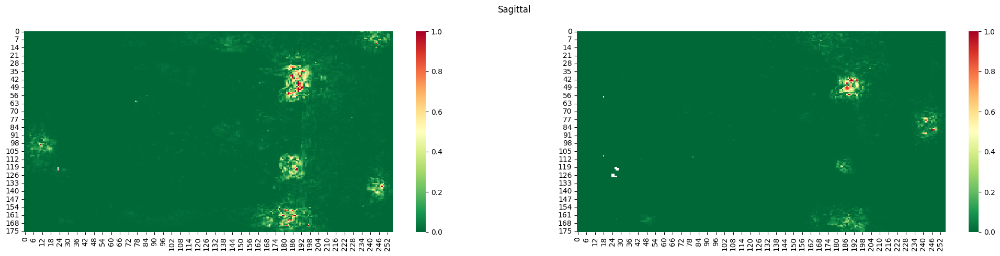

In [39]:
for plane in ['axial', 'coronal', 'sagittal']:
    fig, axes = plt.subplots(1, 2, figsize=(25,5))
    diff = np.abs((ieee_map[plane][0] - snr_map[plane][0]) / ieee_map[plane][0] )
    gc = sns.heatmap(diff, ax=axes[0], vmax=1, vmin=0, cmap='RdYlGn_r')
    diff = np.abs((ieee_map[plane][1] - snr_map[plane][1]) / ieee_map[plane][1] )
    gc = sns.heatmap(diff, ax=axes[1], vmax=1, vmin=0, cmap='RdYlGn_r')
    plt.suptitle(f'{plane.title()}')

**Threshold 0.3**

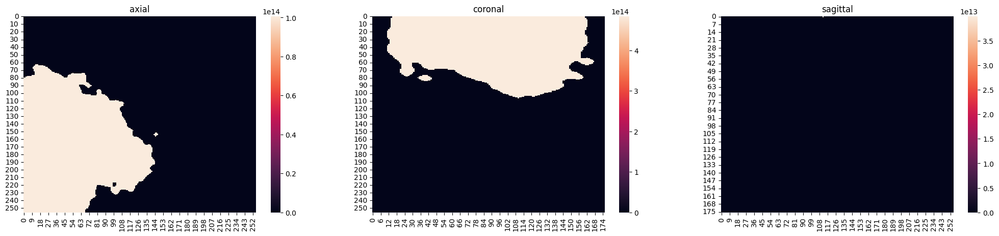

In [40]:
snr_map = {}

for plane in ['axial', 'coronal', 'sagittal']:
    snr_map[plane] = {}
    img = pickle.load(open(f'/scratch/vinuyans/skips/sub-0003002/thresh03/{plane}/raw/60_slice.pkl', 'rb')).squeeze()
    # print(img.shape)
    snr_map0 = calculate_local_snr(img[0].numpy())
    snr_map1 = calculate_local_snr(img[1].numpy())
    snr_map[plane] = {0: snr_map0, 1: snr_map1}

fig, axes = plt.subplots(1, 3, figsize=(25,5))
for num, plane in enumerate(['axial', 'coronal', 'sagittal']):
    gc = sns.heatmap(snr_map[plane][0], ax=axes[num])
    gc.set_title(plane)


/tmp/ipykernel_548447/359527291.py:3: RuntimeWarning: divide by zero encountered in divide
  diff = np.abs((ieee_map[plane][0] - snr_map[plane][0]) / ieee_map[plane][0] )
/tmp/ipykernel_548447/359527291.py:3: RuntimeWarning: divide by zero encountered in divide
  diff = np.abs((ieee_map[plane][0] - snr_map[plane][0]) / ieee_map[plane][0] )
/tmp/ipykernel_548447/359527291.py:3: RuntimeWarning: invalid value encountered in divide
  diff = np.abs((ieee_map[plane][0] - snr_map[plane][0]) / ieee_map[plane][0] )
/tmp/ipykernel_548447/359527291.py:5: RuntimeWarning: divide by zero encountered in divide
  diff = np.abs((ieee_map[plane][1] - snr_map[plane][1]) / ieee_map[plane][1] )
/tmp/ipykernel_548447/359527291.py:5: RuntimeWarning: invalid value encountered in divide
  diff = np.abs((ieee_map[plane][1] - snr_map[plane][1]) / ieee_map[plane][1] )
/tmp/ipykernel_548447/359527291.py:3: RuntimeWarning: divide by zero encountered in divide
  diff = np.abs((ieee_map[plane][0] - snr_map[plane][0])

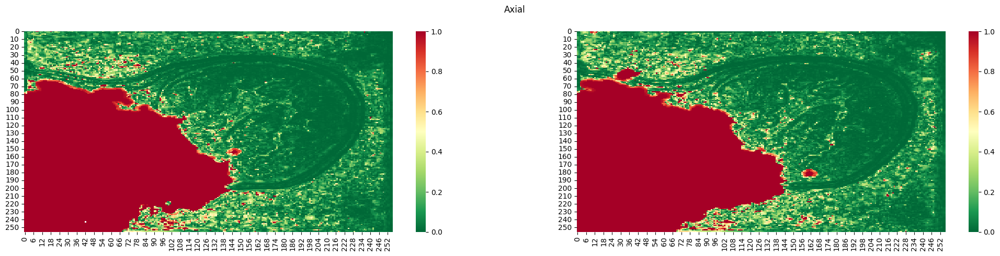

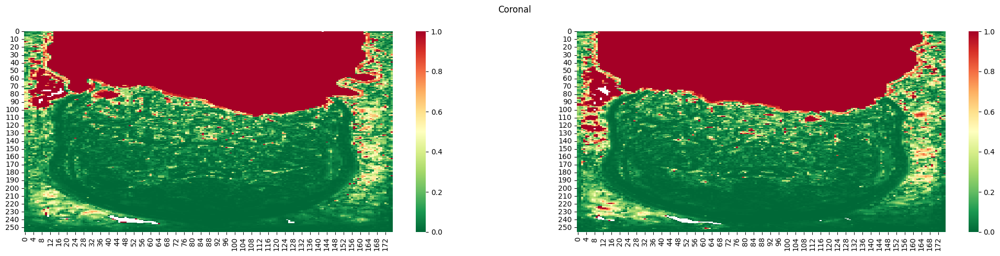

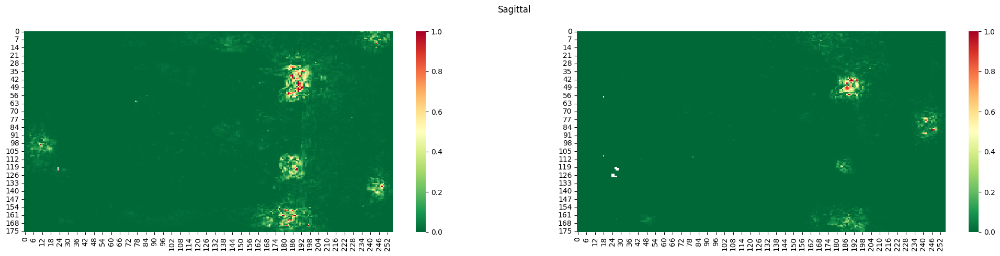

In [41]:
for plane in ['axial', 'coronal', 'sagittal']:
    fig, axes = plt.subplots(1, 2, figsize=(25,5))
    diff = np.abs((ieee_map[plane][0] - snr_map[plane][0]) / ieee_map[plane][0] )
    gc = sns.heatmap(diff, ax=axes[0], vmax=1, vmin=0, cmap='RdYlGn_r')
    diff = np.abs((ieee_map[plane][1] - snr_map[plane][1]) / ieee_map[plane][1] )
    gc = sns.heatmap(diff, ax=axes[1], vmax=1, vmin=0, cmap='RdYlGn_r')
    plt.suptitle(f'{plane.title()}')

### Global SNR

* Default appears to have lower mean in the background than NaN FONDUE -- this correlates to lower SNR
    * It also possibly has higher standard deviation; this also would contribute to lower SNR
* NaN results have higher means in the background and appear to have uniformity there -- correlates to higher SNR
    * Exception is threshold 1 which appears to have higher standard deviation in background; could explain lower SNR

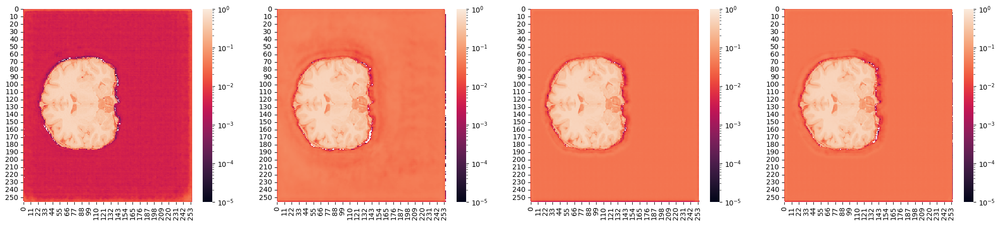

In [21]:
fig, axes = plt.subplots(1, 4, figsize=(25,5))

for num, i in enumerate(['ieee', '1', '05', '075']):
    if i == 'ieee':
        a = pickle.load(open(f"/scratch/vinuyans/skips/sub-0003002/{i}/{plane}/processed/60_slice.pkl", "rb"))                    
    else:
        a = pickle.load(open(f"/scratch/vinuyans/skips/sub-0003002/thresh{i}/{plane}/processed/60_slice.pkl", "rb"))                    
    a.shape


    sns.heatmap((a[0].squeeze()), norm=LogNorm(vmax=1, vmin=1e-5), ax=axes[num])

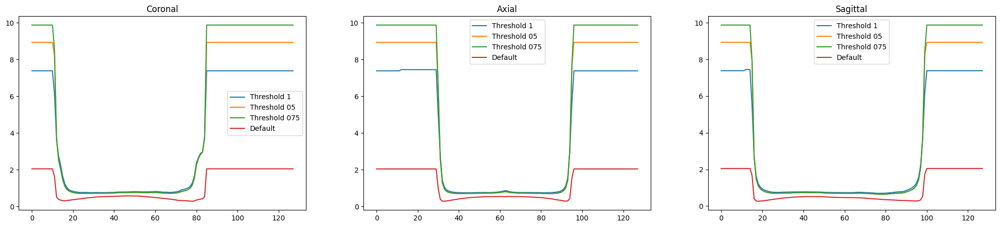

In [10]:
def global_snr_across_slices(filedir):

    fig, axes = plt.subplots(1, 3, figsize=(25,5))
    snr = lambda  x : x.mean()/x.std()


    for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
        
        for thresh in ['1', '05', '075', 'ieee']:
            snr_slices = []

            for i in range(128):

                if thresh == 'ieee': 
                    a = pickle.load(open(f"{filedir}/{thresh}/{plane}/processed/{i}_slice.pkl", "rb"))                    
                else:
                    a = pickle.load(open(f"{filedir}/thresh{thresh}/{plane}/processed/{i}_slice.pkl", "rb"))
    
                #Create MASK FROM IEEE

                snr_slices.append(snr(a).item())

            if thresh == 'ieee': 
                axes[num].plot(snr_slices, label=f'Default')            
            else:
                axes[num].plot(snr_slices, label=f'Threshold {thresh}')
        axes[num].legend()
        axes[num].set_title(plane.title())
        
global_snr_across_slices('/scratch/vinuyans/skips/sub-0003002')

In [ ]:
#GLOBAL SNR
snr = lambda  x : x.mean()/x.std()

views = {
    'Axial': (127, slice(None), slice(None)),
    'Coronal': (slice(None), 127, slice(None)),
    'Sagittal': (slice(None), slice(None), 127)
}

def calculate_local_snr(image, patch_size=3):
    """
    Calculate the local SNR of a 2D brain slice image using scipy.ndimage.
    
    Parameters:
    - image: 2D NumPy array, the brain slice image
    - patch_size: int, the size of the patches to divide the image into
    
    Returns:
    - snr_map: 2D NumPy array, the local SNR values
    """
    # Ensure the image is a 2D array
    if len(image.shape) != 2:
        raise ValueError("Input image must be a 2D array.")
    # Calculate local mean
    local_mean = ndimage.uniform_filter(image, size=patch_size)
    
    # Calculate local squared mean
    local_sq_mean = ndimage.uniform_filter(image**2, size=patch_size)
    
    # Calculate local variance (E[X^2] - (E[X])^2)
    local_variance = local_sq_mean - local_mean**2
    
    # Calculate local standard deviation
    local_std = np.sqrt(local_variance)
    
    # Avoid division by zero
    local_std[local_std == 0] = np.finfo(float).eps
    
    # Calculate local SNR (mean / std)
    snr_map = local_mean / local_std
    
    return np.abs(snr_map)


def plot_single_compare(nan_out, ieee, base, nan_thresh, view):
    fig, axes = plt.subplots(2, 3, figsize=(25,10))
    view_index = views[view]
    out = nib.load(os.path.join(nan_out)).get_fdata()
    gc = sns.heatmap(out[view_index].squeeze(), ax=axes[0][0])
    gc.set_title(f'NaN {nan_thresh} Output')
    gc.set_ylabel(f"{view} View")

    out = nib.load(os.path.join(ieee)).get_fdata()
    gc = sns.heatmap(out[view_index].squeeze(), ax=axes[0][1])
    gc.set_title(f'IEEE Single Segment Output')

    out = nib.load(os.path.join(base)).get_fdata()
    gc = sns.heatmap(out[view_index].squeeze(), ax=axes[0][2])
    gc.set_title(f'Original MRI')

    snr = lambda  x : x.mean()/x.std()

    out = nib.load(os.path.join(nan_out)).get_fdata()
    nan = calculate_local_snr(out[view_index])
    gc = sns.heatmap(nan, ax=axes[1][0], vmin=0, vmax=200)
    gc.set_title(f'NaN {nan_thresh} Output - Global SNR: {snr(out[view_index])}')
    gc.set_ylabel("Local SNR")

    out = nib.load(os.path.join(ieee)).get_fdata()
    ieee = calculate_local_snr(out[view_index])
    gc = sns.heatmap(ieee, ax=axes[1][1], vmin=0, vmax=200)
    gc.set_title(f'IEEE Single Segment Output - Global SNR: {snr(out[view_index])}')
    
    out = nib.load(os.path.join(base)).get_fdata()
    gc = sns.heatmap(calculate_local_snr(out[view_index]), ax=axes[1][2], vmin=0, vmax=200)
    gc.set_title(f'Original MRI - Global SNR: {snr(out[view_index])}')

    plt.suptitle(f"Absolute Error - Nan SNR vs IEEE SNR", y=1.02, fontsize=15)
    
    fig, axes = plt.subplots(1, 1, figsize=(15,10))
    gc = sns.heatmap(nan - ieee, ax=axes, vmin=-100, vmax=100, cmap='RdYlGn')
    gc.set_title(f'IEEE Single Segment Output - Global SNR: {snr(out[view_index])}')

def get_slices(mri, view):
    if view == 'Sagittal':
        return [mri[i, :, :] for i in range(mri.shape[0])]
    elif view == 'Axial':
        return [mri[:, i, :] for i in range(mri.shape[1])]
    else:
        return [mri[:, :, i] for i in range(mri.shape[2])]

def plot_final_compare(nan_out, ieee_whole, view, nan_thresh=1.0):
    # snr = lambda  x : x.mean()/x.std()
    snr = lambda x: np.nanmean(x) / np.nanstd(x)
    nan_result = nib.load(os.path.join(nan_out))
    ieee_results = nib.load(os.path.join(ieee_whole))
    
    # Compute the brain mask from the entire nan_result image
    mask_nan = masking.compute_brain_mask(nan_result)
    mask_ieee = masking.compute_brain_mask(nan_result)
    
    nan_result = nan_result.get_fdata()
    ieee_results = ieee_results.get_fdata()
    
    nan_slices = get_slices(nan_result, view)
    ieee_slices = get_slices(ieee_results, view)
    
    for i in range(0, len(nan_slices), 5):    
        fig, axes = plt.subplots(1, 4, figsize=(18,5))
        nan = calculate_local_snr(nan_slices[i])
        gc = sns.heatmap(nan, ax=axes[0], vmin=0, vmax=200)
        gc.set_title(f'NaN - Global SNR: {round(snr(nan_slices[i] * np.where(nan_slices[i] > 5.0, nan_slices[i], np.nan)), 4)}')
        gc.set_ylabel(view)

        
        ieee = calculate_local_snr(ieee_slices[i])
        gc = sns.heatmap(ieee, ax=axes[1], vmin=0, vmax=200)
        gc.set_title(f'IEEE - Global SNR: {round(snr(ieee_slices[i]* np.where(ieee_slices[i] > 5.0, ieee_slices[i], np.nan)), 4)}')        
        
        gc = sns.heatmap(nan - ieee, ax=axes[2], vmin=-50, vmax=50, cmap='RdYlGn')
        gc.set_title(f'Difference between Nan and IEEE SNR')
        
        
        gc = sns.heatmap(ieee_slices[i], ax=axes[3])
        gc.set_title(f'IEEE Output')  
    
        plt.suptitle(f"Nan {nan_thresh}  SNR vs IEEE SNR - Slice {i}", y=1.02, fontsize=15)
        
        plt.show()

## SSIM

**OLD SSIM Calculation -- To be Dropped**
Background is not removed and thus interferes with SSIM

/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/axes/_base.py:2917: RuntimeWarning: overflow encountered in scalar add
  x0, x1 = inverse_trans.transform([x0t - delta, x1t + delta])


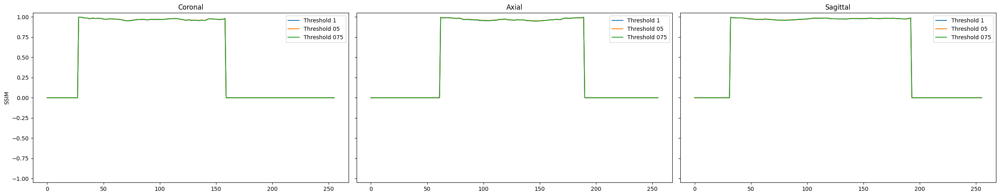

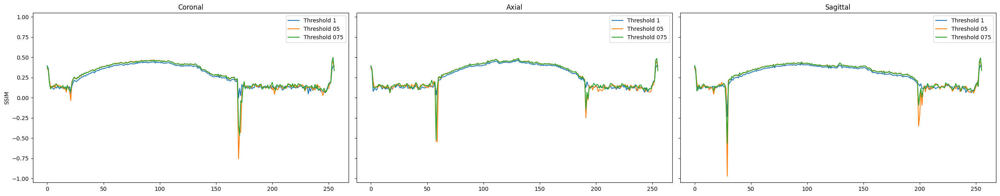

In [9]:
def ssim_across_slices_old(filedir, mask=True, share=True):

    fig, axes = plt.subplots(1, 3, figsize=(25,5), sharey=share)

    ssim_dict = {}



    for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
    # for num, plane in enumerate(['coronal']):
        ssim_dict[plane] = {}
        
        for thresh in ['1', '05', '075']:
        # for thresh in ['05']:
            # snr_slices1 = []
            ssim_slices = []
            ssim_dict[plane][thresh] = []

            if mask:
                ieee_img = getvol('/scratch/vinuyans/skips/ieee/sub-0003002/sub-0003002_ieee_whole_mask.nii.gz')
                thresh_img = getvol(f'/scratch/vinuyans/skips/sub-0003002/thresh{thresh}/sub-0003002_thresh{thresh}_aggr_masked.nii.gz')
            else:
                ieee_img = getvol('/scratch/vinuyans/skips/ieee/sub-0003002/sub-0003002_ieee_whole.nii.gz')
                thresh_img = getvol(f'/scratch/vinuyans/skips/sub-0003002/thresh{thresh}/sub-0003002_thresh{thresh}_aggr.nii.gz')

            for i in range(256):

                # ieee_slice = pickle.load(open(f"{filedir}/ieee/{plane}/processed/{i}_slice.pkl", "rb")) #.squeeze()[0].numpy()      
                # thresh_slice = pickle.load(open(f"{filedir}/thresh{thresh}/{plane}/processed/{i}_slice.pkl", "rb")) #.squeeze()[0].numpy()                  
                if plane == 'axial':
                    ieee_slice = ieee_img[i]
                    thresh_slice = thresh_img[i]
                elif plane == 'sagittal':
                    ieee_slice = ieee_img[:, :, i]
                    thresh_slice = thresh_img[:, :, i]
                else:
                    ieee_slice = ieee_img[:, i, :]
                    thresh_slice = thresh_img[:, i, :]

                ieee_slice = torch.from_numpy(ieee_slice).to('cpu').type(torch.float16) 
                thresh_slice = torch.from_numpy(thresh_slice).to('cpu').type(torch.float16) 

                ieee_slice = (ieee_slice - ieee_slice.min()) / (ieee_slice.max() - ieee_slice.min())
                thresh_slice = (thresh_slice - thresh_slice.min()) / (thresh_slice.max() - thresh_slice.min())

                ieee_slice = torch.unsqueeze(ieee_slice, 0)
                thresh_slice = torch.unsqueeze(thresh_slice, 0)
                
                ssim_slices.append( ssim(torch.unsqueeze(ieee_slice,0),torch.unsqueeze(thresh_slice,0), data_range = 1).cpu().detach().numpy().item() )

            ssim_dict[plane][thresh] = ssim_slices

            axes[num].plot(np.nan_to_num(ssim_slices), label=f'Threshold {thresh}')
        axes[num].legend()
        axes[num].set_title(plane.title(), fontsize=18)
    axes[0].set_ylabel('SSIM', fontsize=15)
    axes[0].set_ylim(-1.05, 1.05)
    plt.tight_layout()

    return ssim_dict



ssim_slices_mask = ssim_across_slices_old("/scratch/vinuyans/skips/sub-0003002", mask=True, share=True)
ssim_slices_nomask = ssim_across_slices_old("/scratch/vinuyans/skips/sub-0003002", mask=False, share=True)


**NEW SSIM Calculation -- extract only brain matter using mask**

/tmp/ipykernel_1471677/3200158058.py:53: RuntimeWarning: invalid value encountered in divide
  ieee_slice = (ieee_slice - ieee_slice.min()) / (ieee_slice.max() - ieee_slice.min())
/tmp/ipykernel_1471677/3200158058.py:54: RuntimeWarning: invalid value encountered in divide
  thresh_slice = (thresh_slice - thresh_slice.min()) / (thresh_slice.max() - thresh_slice.min())


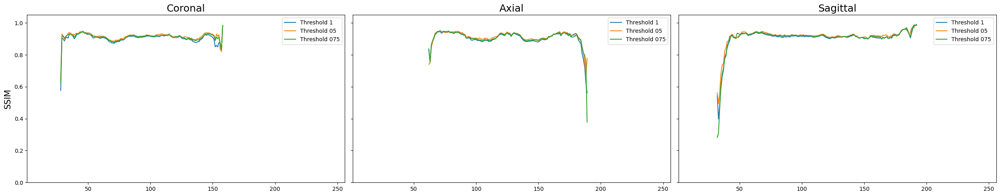

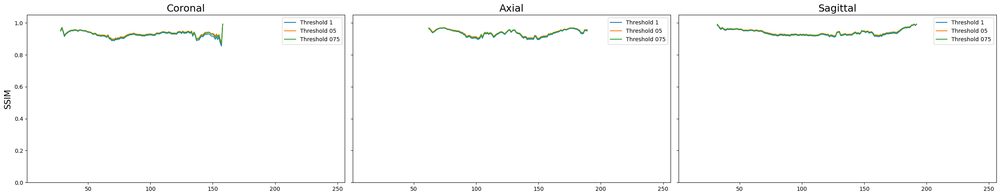

In [46]:
from skimage.metrics import structural_similarity as ssim

def ssim_across_slices_scipy(filedir, masked=True, share=True):

    fig, axes = plt.subplots(1, 3, figsize=(25,5), sharey=share)

    ssim_dict = {}



    for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
    # for num, plane in enumerate(['coronal']):
        ssim_dict[plane] = {}
        
        for thresh in ['1', '05', '075']:
        # for thresh in ['05']:
            # snr_slices1 = []
            ssim_slices = []
            ssim_dict[plane][thresh] = []

            mask_template = getvol('/scratch/vinuyans/skips/ieee/sub-0003002/sub-0003002_ieee_whole_mask.nii.gz')
            if masked:
                ieee_img = getvol('/scratch/vinuyans/skips/ieee/sub-0003002/sub-0003002_ieee_whole_mask.nii.gz')
                thresh_img = getvol(f'/scratch/vinuyans/skips/sub-0003002/thresh{thresh}/sub-0003002_thresh{thresh}_aggr_masked.nii.gz')
            else:
                ieee_img = getvol('/scratch/vinuyans/skips/ieee/sub-0003002/sub-0003002_ieee_whole.nii.gz')
                thresh_img = getvol(f'/scratch/vinuyans/skips/sub-0003002/thresh{thresh}/sub-0003002_thresh{thresh}_aggr.nii.gz')

            #get mask
            mask = np.where(mask_template == 0, False, True).squeeze()


            for i in range(256):

                # ieee_slice = pickle.load(open(f"{filedir}/ieee/{plane}/processed/{i}_slice.pkl", "rb")) #.squeeze()[0].numpy()      
                # thresh_slice = pickle.load(open(f"{filedir}/thresh{thresh}/{plane}/processed/{i}_slice.pkl", "rb")) #.squeeze()[0].numpy()                  
                if plane == 'axial':
                    ieee_slice = ieee_img[i]
                    thresh_slice = thresh_img[i]
                    mask_slice = mask[i]
                elif plane == 'sagittal':
                    ieee_slice = ieee_img[:, :, i]
                    thresh_slice = thresh_img[:, :, i]
                    mask_slice = mask[:, :, i]
                else:
                    ieee_slice = ieee_img[:, i, :]
                    thresh_slice = thresh_img[:, i, :]
                    mask_slice = mask[:, i, :]

                # ieee_slice = torch.from_numpy(ieee_slice).to('cpu').type(torch.float16) 
                # thresh_slice = torch.from_numpy(thresh_slice).to('cpu').type(torch.float16) 

                ieee_slice = (ieee_slice - ieee_slice.min()) / (ieee_slice.max() - ieee_slice.min())
                thresh_slice = (thresh_slice - thresh_slice.min()) / (thresh_slice.max() - thresh_slice.min())

                # ieee_slice = torch.unsqueeze(ieee_slice, 0)
                # thresh_slice = torch.unsqueeze(thresh_slice, 0)

                try:
                    ssim_noise = ssim(ieee_slice[mask_slice != False], thresh_slice[mask_slice != False], data_range=1)
                except:
                    ssim_noise = None

                ssim_slices.append( ssim_noise )
                
                # ssim_slices.append( ssim(torch.unsqueeze(ieee_slice,0),torch.unsqueeze(thresh_slice,0), data_range = 1).cpu().detach().numpy().item() )

            ssim_dict[plane][thresh] = ssim_slices

            axes[num].plot(np.nan_to_num(ssim_slices), label=f'Threshold {thresh}')
            # break
        axes[num].legend()
        axes[num].set_xlim(1, 256)

        axes[num].set_title(plane.title(), fontsize=18)
        # break
    axes[0].set_ylabel('SSIM', fontsize=15)
    axes[0].set_ylim(0, 1.05)
    plt.tight_layout()

    return ssim_dict


ssim_slices_mask = ssim_across_slices_scipy("/scratch/vinuyans/skips/sub-0003002", masked=True, share=True)
ssim_slices_nomask = ssim_across_slices_scipy("/scratch/vinuyans/skips/sub-0003002", masked=False, share=True)


In [4]:
ssim_slices_mask = pickle.load(open('fondue_ssim_nomask.pkl', 'rb'))
ssim_slices_nomask = pickle.load(open('fondue_ssim_mask.pkl', 'rb'))

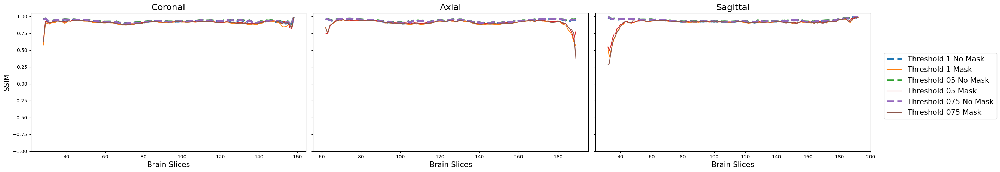

In [47]:
fig, axes = plt.subplots(1, 3, figsize=(25,5), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
    for thresh in ssim_slices_mask[plane].keys():
        axes[num].plot(np.nan_to_num(ssim_slices_nomask[plane][thresh]), linestyle='dashed', linewidth=4, label=f'Threshold {thresh} No Mask')
        axes[num].plot(np.nan_to_num(ssim_slices_mask[plane][thresh]), label=f'Threshold {thresh} Mask')
        axes[num].set_xlabel('Brain Slices', fontsize=15)

    # axes[num].legend(fontsize=15)
    axes[num].set_title(plane.title(),fontsize=18)
axes[0].set_ylabel('SSIM', fontsize=15)
axes[0].set_ylim(-1,1.05)

# Gather unique handles and labels from subplots
handles, labels = [], []
for ax in axes:
    for handle, label in zip(*ax.get_legend_handles_labels()):
        if label not in labels:
            handles.append(handle)
            labels.append(label)

# Create a single legend outside the plot using the unique handles and labels
fig.legend( handles, labels, fontsize=15, loc='center left', bbox_to_anchor=(1, 0.5))

# fig.legend(fontsize=15, loc='center left', bbox_to_anchor=(1, 0.5), title="Legend")

plt.tight_layout();


In [48]:
mask_template = getvol('/scratch/vinuyans/skips/ieee/sub-0003002/sub-0003002_ieee_whole_mask.nii.gz').squeeze()
mask = np.where(mask_template == 0, False, True).squeeze()

for thresh in ['1', '05', '075']:

    ieee_slice = getvol('/scratch/vinuyans/skips/ieee/sub-0003002/sub-0003002_ieee_whole_mask.nii.gz').squeeze()
    thresh_slice = getvol(f'/scratch/vinuyans/skips/sub-0003002/thresh{thresh}/sub-0003002_thresh{thresh}_aggr_masked.nii.gz').squeeze()

    # ieee_slice = torch.from_numpy(ieee_slice).to('cpu').type(torch.float16) 
    # thresh_slice = torch.from_numpy(thresh_slice).to('cpu').type(torch.float16) 

    ieee_slice = (ieee_slice - ieee_slice.min()) / (ieee_slice.max() - ieee_slice.min())
    thresh_slice = (thresh_slice - thresh_slice.min()) / (thresh_slice.max() - thresh_slice.min())

    # ieee_slice = torch.unsqueeze(ieee_slice, 0)
    # thresh_slice = torch.unsqueeze(thresh_slice, 0)

    # print('MASK Threshold ', thresh, ' SSIM ', ssim(torch.unsqueeze(ieee_slice,0),torch.unsqueeze(thresh_slice,0), data_range = 1).cpu().detach().numpy().item() )
    print('MASK Threshold ', thresh, ' SSIM ', ssim(ieee_slice[mask != False], thresh_slice[mask != False], data_range=1) )

    ieee_slice = getvol('/scratch/vinuyans/skips/ieee/sub-0003002/sub-0003002_ieee_whole.nii.gz')
    thresh_slice = getvol(f'/scratch/vinuyans/skips/sub-0003002/thresh{thresh}/sub-0003002_thresh{thresh}_aggr.nii.gz')

    # ieee_slice = torch.from_numpy(ieee_slice).to('cpu').type(torch.float16) 
    # thresh_slice = torch.from_numpy(thresh_slice).to('cpu').type(torch.float16) 

    ieee_slice = (ieee_slice - ieee_slice.min()) / (ieee_slice.max() - ieee_slice.min())
    thresh_slice = (thresh_slice - thresh_slice.min()) / (thresh_slice.max() - thresh_slice.min())

    # ieee_slice = torch.unsqueeze(ieee_slice, 0)
    # thresh_slice = torch.unsqueeze(thresh_slice, 0)

    # print('NO MASK Threshold ', thresh, ' SSIM ', ssim(torch.unsqueeze(ieee_slice,0),torch.unsqueeze(thresh_slice,0), data_range = 1).cpu().detach().numpy().item() )
    print('NO MASK Threshold ', thresh, ' SSIM ', ssim(ieee_slice[mask != False], thresh_slice[mask != False], data_range=1) )




MASK Threshold  1  SSIM  0.913845475210286
NO MASK Threshold  1  SSIM  0.9496586903205468
MASK Threshold  05  SSIM  0.9214991819912328
NO MASK Threshold  05  SSIM  0.9542590897004096
MASK Threshold  075  SSIM  0.9176685003263383
NO MASK Threshold  075  SSIM  0.9522289760009884


In [49]:
pickle.dump(ssim_slices_mask, open('fondue_ssim_nomask.pkl', 'wb'))
pickle.dump(ssim_slices_nomask, open('fondue_ssim_mask.pkl', 'wb'))